In [ ]:
import pandas as pd
import numpy as np

In [ ]:
df=pd.read_csv('/content/drive/MyDrive/Colab Notebooks/telecom_churn.csv')
df.head()

,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn
0,KS,128,415,No,Yes,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,False
1,OH,107,415,No,Yes,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,False
2,NJ,137,415,No,No,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,False
3,OH,84,408,Yes,No,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False
4,OK,75,415,Yes,No,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False


Задача создать модель, предсказывающую отток клиентов. Целевой признак - **Churn** (бинарный, 1- потеряем клиента, 0 - не потеряем). Задача бинарной классификации.

**Описание полей**</br>
Название - Описание - Тип </br>
- **State** - Буквенный код штата - номинальный</br>
- **Account length** - Как долго клиент обслуживается компанией - количественный</br>
- **Area code** - Префикс номера телефона - количественный</br>
- **International plan** - Международный роуминг (подключен/не подключен) - бинарный</br>
- **Voice mail plan** - Голосовая почта (подключена/не подключена) - бинарный</br>
- **Number vmail messages** - Количество голосовых сообщений - количественный</br>
- **Total day minutes** - Общая длительность разговоров днем - количественный</br>
- **Total day calls** - Общее количество звонков днем - количественный</br>
- **Total day charge** - Общая сумма оплаты за услуги днем - количественный</br>
- **Total eve minutes** - Общая длительность разговоров вечером - количественный</br>
- **Total eve calls** - Общее количество звонков вечером - количественный</br>
- **Total eve charge** - Общая сумма оплаты за услуги вечером - количественный</br>
- **Total night minutes** - Общая длительность разговоров ночью - количественный</br>
- **Total night calls** - Общее количество звонков ночью - количественный</br>
- **Total night charge** - Общая сумма оплаты за услуги ночью - количественный</br>
- **Total intl minutes** - Общая длительность международных разговоров - количественный</br>
- **Total intl calls** - Общее количество международных разговоров - количественный</br>
- **Total intl charge** - Общая сумма оплаты за международные разговоры - количественный</br>
- **Customer service calls** - Число обращений в сервисный центр - количественный

In [ ]:
df.shape #количество строк и столбцов

(3333, 20)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3333 entries, 0 to 3332
Data columns (total 20 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   State                   3333 non-null   object 
 1   Account length          3333 non-null   int64  
 2   Area code               3333 non-null   int64  
 3   International plan      3333 non-null   object 
 4   Voice mail plan         3333 non-null   object 
 5   Number vmail messages   3333 non-null   int64  
 6   Total day minutes       3333 non-null   float64
 7   Total day calls         3333 non-null   int64  
 8   Total day charge        3333 non-null   float64
 9   Total eve minutes       3333 non-null   float64
 10  Total eve calls         3333 non-null   int64  
 11  Total eve charge        3333 non-null   float64
 12  Total night minutes     3333 non-null   float64
 13  Total night calls       3333 non-null   int64  
 14  Total night charge      3333 non-null   

#Scikit-learn

In [ ]:
df_skl=df.copy(deep=True) #делаю копию датафрейма для работы с ним в бибилиотеке Scikit-learn

In [ ]:
#меняем тип у не числовых переменноых
df_skl['Churn']=df_skl['Churn'].astype('int64')
d={'No':0, 'Yes':1}
df_skl['International plan']=df_skl['International plan'].map(d) #поменяли No на 0, Yes на 1 в столбце International plan
df_skl['Voice mail plan']=df_skl['Voice mail plan'].map(d) #поменяли No на 0, Yes на 1 в столбце Voice mail plan

In [ ]:
df_skl.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3333 entries, 0 to 3332
Data columns (total 20 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   State                   3333 non-null   object 
 1   Account length          3333 non-null   int64  
 2   Area code               3333 non-null   int64  
 3   International plan      3333 non-null   int64  
 4   Voice mail plan         3333 non-null   int64  
 5   Number vmail messages   3333 non-null   int64  
 6   Total day minutes       3333 non-null   float64
 7   Total day calls         3333 non-null   int64  
 8   Total day charge        3333 non-null   float64
 9   Total eve minutes       3333 non-null   float64
 10  Total eve calls         3333 non-null   int64  
 11  Total eve charge        3333 non-null   float64
 12  Total night minutes     3333 non-null   float64
 13  Total night calls       3333 non-null   int64  
 14  Total night charge      3333 non-null   

In [ ]:
df_skl.head(5).append(df_skl.tail(5)) #смотрим 5 первых и 5 последних строки датасета

,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn
0,KS,128,415,0,1,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,0
1,OH,107,415,0,1,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,0
2,NJ,137,415,0,0,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,0
3,OH,84,408,1,0,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,0
4,OK,75,415,1,0,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,0
3328,AZ,192,415,0,1,36,156.2,77,26.55,215.5,126,18.32,279.1,83,12.56,9.9,6,2.67,2,0
3329,WV,68,415,0,0,0,231.1,57,39.29,153.4,55,13.04,191.3,123,8.61,9.6,4,2.59,3,0
3330,RI,28,510,0,0,0,180.8,109,30.74,288.8,58,24.55,191.9,91,8.64,14.1,6,3.81,2,0
3331,CT,184,510,1,0,0,213.8,105,36.35,159.6,84,13.57,139.2,137,6.26,5.0,10,1.35,2,0
3332,TN,74,415,0,1,25,234.4,113,39.85,265.9,82,22.60,241.4,77,10.86,13.7,4,3.70,0,0


In [ ]:
df_skl.describe(include='object') #смотрим описание столбца типа object

,State
count,3333
unique,51
top,WV
freq,106


In [ ]:
df_skl['State'].value_counts() # смотрим распределение данных в столбце State

WV    106
MN     84
NY     83
AL     80
OH     78
OR     78
WI     78
VA     77
WY     77
CT     74
ID     73
VT     73
MI     73
TX     72
UT     72
IN     71
MD     70
KS     70
NJ     68
MT     68
NC     68
WA     66
CO     66
NV     66
RI     65
MA     65
MS     65
AZ     64
FL     63
MO     63
ME     62
NM     62
ND     62
NE     61
DE     61
OK     61
SD     60
SC     60
KY     59
IL     58
NH     56
AR     55
GA     54
DC     54
HI     53
TN     53
AK     52
LA     51
PA     45
IA     44
CA     34
Name: State, dtype: int64

In [ ]:
df_skl=pd.get_dummies(df_skl, columns=['State']) #создаем столбцы индикатора из столбца State и удаляем сам этот столбец
df_skl.head()

,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn,State_AK,State_AL,State_AR,State_AZ,State_CA,State_CO,State_CT,State_DC,State_DE,State_FL,State_GA,State_HI,State_IA,State_ID,State_IL,State_IN,State_KS,State_KY,State_LA,State_MA,State_MD,State_ME,State_MI,State_MN,State_MO,State_MS,State_MT,State_NC,State_ND,State_NE,State_NH,State_NJ,State_NM,State_NV,State_NY,State_OH,State_OK,State_OR,State_PA,State_RI,State_SC,State_SD,State_TN,State_TX,State_UT,State_VA,State_VT,State_WA,State_WI,State_WV,State_WY
0,128,415,0,1,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,107,415,0,1,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,137,415,0,0,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,84,408,1,0,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,75,415,1,0,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
df_skl.shape

(3333, 70)

In [ ]:
df_skl.isna().values.any() #есть пропущенные значения?

False

In [ ]:
df_skl['Churn'].value_counts() # смотрим распределение данных в столбце Churn. Набор данных несбалансированный

0    2850
1     483
Name: Churn, dtype: int64

In [ ]:
data = df_skl.sample(frac=0.95, random_state=786) #датасет без 5% данных, с которым будем дальше работать
data_unseen_skl = df_skl.drop(data.index) #выделяем 5% из исходного датасета, которые будут использоваться для прогнозов при проверке модели
data.reset_index(inplace=True, drop=True)
data_unseen_skl.reset_index(inplace=True, drop=True)
print('Данные для моделирования: ' + str(data.shape))
print('Новые данные для прогноза: ' + str(data_unseen_skl.shape))

Данные для моделирования: (3166, 70)
Новые данные для прогноза: (167, 70)


In [ ]:
from sklearn.model_selection import train_test_split
#делим датасет на два набора данных: один для обучения (80%) и один — для тестирования (20%) 
train_x, test_x, train_y, test_y=train_test_split(data.drop('Churn', axis=1),data['Churn'],test_size=0.2, random_state=18)

In [ ]:
train_x.shape

(2532, 69)

In [ ]:
test_x.shape

(634, 69)

In [ ]:
train_y.shape

(2532,)

In [ ]:
test_y.shape

(634,)

## Случайный лес

In [ ]:
from sklearn.ensemble import RandomForestClassifier

skl_rfc = RandomForestClassifier( random_state=348 ) #модель 
skl_rfc.fit(train_x, train_y) #обучаем

RandomForestClassifier(random_state=348)

In [ ]:
skl_rfc_predicted=skl_rfc.predict(test_x) #тестируем модель
skl_rfc.score(test_x,test_y) # смотрим среднее значение accuracy - аккуратность: процент (коэффициент) случаев, классифицированных правильно

0.9290220820189274

In [ ]:
from sklearn.metrics import roc_auc_score
skl_rfc_probabilities = skl_rfc.predict_proba(test_x ) #создаем набор вероятностей прогнозирования на основе тестовых данных. результат функции таблица, где первый столбец - вероятность что Churn=0, второй, что Churn=1

In [ ]:
roc_auc_score(test_y, skl_rfc_probabilities[:,1] ) #считаем оценки ROC AUC, первый параметр фактические значения Churn, второй - вероятность что Churn=1 

0.9337724890211079

0.9337724890211079

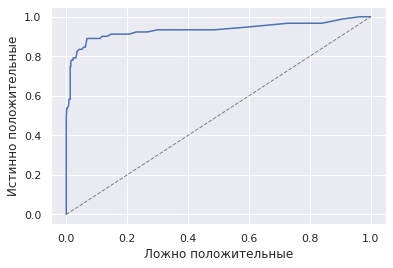

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns

sns.set()
from sklearn import metrics
from sklearn.metrics import roc_curve

fpr,tpr,_=roc_curve(test_y, skl_rfc_probabilities[:,1])
plt.plot(fpr,tpr)
plt.plot([0,1],[0,1],color='grey', lw=1,linestyle='--')
plt.xlabel('Ложно положительные')
plt.ylabel('Истинно положительные')
metrics.auc(fpr,tpr)

In [ ]:
from sklearn.metrics import confusion_matrix
confusion_matrix(test_y, skl_rfc_predicted) # матрица неточностей

array([[539,   4],
       [ 41,  50]])

539 - действующий клиент, предсказан правильно, т.е. что не потеряем (истинно положительное) </br>
4 - действующий клиент, предсказан неправильно, т.е. что потеряем (ложно отрицательное)</br>
41 - предсказан что не потеряем, но на самом деле потеряли (ложно положительное)</br>
50 - предсказан что потеряем и потеряли (истинно отрицательное)</br>
Судя по этой матрице, модель потерю клиента предсказывает хуже, чем то что он останется.

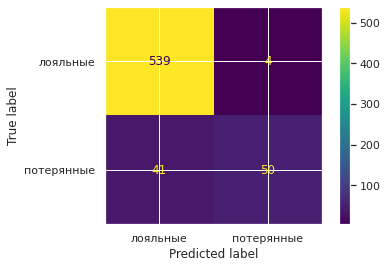

In [ ]:
disp=metrics.plot_confusion_matrix(skl_rfc, test_x, test_y, values_format='n', display_labels=['лояльные', 'потерянные'])

In [ ]:
from sklearn.metrics import precision_score
skl_rfc_train_predictions=skl_rfc.predict(train_x)
precision_score( train_y, skl_rfc_train_predictions) # измеряем точность модели (Precision) - доля правильных ответов модели во всех предсказанных как положительные

1.0

In [ ]:
precision_score_test=precision_score(test_y, skl_rfc_predicted)
precision_score_test

0.9259259259259259

In [ ]:
from sklearn.metrics import recall_score
recall_score(train_y, skl_rfc_train_predictions) # измеряем полноту (Recall) - показывает какую долю объектов, реально относящихся к положительному классу, мы предсказали верно

1.0

In [ ]:
recall_score_test=recall_score(test_y, skl_rfc_predicted)
recall_score_test

0.5494505494505495

In [ ]:
skl_rfc_unseen=data_unseen_skl.copy(deep=True) # скопировала данные для прогнозирования в отдельный датасет
skl_rfc_unseen.shape

(167, 70)

In [ ]:
skl_rfc_unseen['Churn'].value_counts() # смотрим сколько в нем ушедших и оставшихся клиентов

0    145
1     22
Name: Churn, dtype: int64

In [ ]:
data_unseen_=data_unseen_skl.drop('Churn', axis=1) #датасет без столбца Churn для прогнозирования

skl_rfc_result=skl_rfc.predict(data_unseen_)
skl_rfc_unseen.insert(loc=18,column='Predicted', value=skl_rfc_result)
skl_rfc_unseen.sort_values(by='Churn',ascending=False).head(22)

,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Predicted,Churn,State_AK,State_AL,State_AR,State_AZ,State_CA,State_CO,State_CT,State_DC,State_DE,State_FL,State_GA,State_HI,State_IA,State_ID,State_IL,State_IN,State_KS,State_KY,State_LA,State_MA,State_MD,State_ME,State_MI,State_MN,State_MO,State_MS,State_MT,State_NC,State_ND,State_NE,State_NH,State_NJ,State_NM,State_NV,State_NY,State_OH,State_OK,State_OR,State_PA,State_RI,State_SC,State_SD,State_TN,State_TX,State_UT,State_VA,State_VT,State_WA,State_WI,State_WV,State_WY
123,89,415,0,0,0,326.3,112,55.47,165.1,110,14.03,162.9,97,7.33,7.5,1,2.03,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
80,68,415,0,0,0,213.9,112,36.36,260.5,100,22.14,233.8,97,10.52,8.4,3,2.27,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
34,152,415,1,1,20,237.5,120,40.38,253.4,94,21.54,265.2,80,11.93,14.2,3,3.83,9,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
107,162,408,0,0,0,217.6,87,36.99,279.0,71,23.72,250.7,65,11.28,10.4,4,2.81,2,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
61,108,415,0,0,0,154.2,123,26.21,112.3,86,9.55,246.4,75,11.09,15.4,4,4.16,4,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
58,112,415,0,0,0,111.9,92,19.02,114.0,143,9.69,146.8,79,6.61,14.1,3,3.81,5,1,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
151,131,408,1,0,0,122.3,83,20.79,118.8,94,10.10,147.9,95,6.66,13.7,3,3.70,3,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
152,108,408,1,0,0,115.1,114,19.57,211.3,70,17.96,136.1,85,6.12,13.8,3,3.73,2,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
100,103,408,0,0,0,150.6,125,25.60,169.1,126,14.37,221.2,104,9.95,10.4,8,2.81,8,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
131,116,408,0,0,0,288.0,120,48.96,255.8,90,21.74,233.4,99,10.50,13.4,4,3.62,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0


In [ ]:
res_rfc=skl_rfc_unseen.where((skl_rfc_unseen['Churn']==1)&(skl_rfc_unseen['Predicted']==1)) #датасет с данными где предсказали прекращение контракта и это на самом деле случилось
res_rfc=res_rfc.dropna() #
res_rfc.head(22) #

,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Predicted,Churn,State_AK,State_AL,State_AR,State_AZ,State_CA,State_CO,State_CT,State_DC,State_DE,State_FL,State_GA,State_HI,State_IA,State_ID,State_IL,State_IN,State_KS,State_KY,State_LA,State_MA,State_MD,State_ME,State_MI,State_MN,State_MO,State_MS,State_MT,State_NC,State_ND,State_NE,State_NH,State_NJ,State_NM,State_NV,State_NY,State_OH,State_OK,State_OR,State_PA,State_RI,State_SC,State_SD,State_TN,State_TX,State_UT,State_VA,State_VT,State_WA,State_WI,State_WV,State_WY
5,94.0,408.0,0.0,0.0,0.0,157.9,105.0,26.84,155.0,101.0,13.18,189.6,84.0,8.53,8.0,5.0,2.16,4.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
30,88.0,415.0,0.0,0.0,0.0,264.8,124.0,45.02,245.4,112.0,20.86,160.5,115.0,7.22,14.8,2.0,4.00,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
49,127.0,408.0,1.0,0.0,0.0,176.9,110.0,30.07,167.9,100.0,14.27,182.2,138.0,8.20,7.7,2.0,2.08,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
58,112.0,415.0,0.0,0.0,0.0,111.9,92.0,19.02,114.0,143.0,9.69,146.8,79.0,6.61,14.1,3.0,3.81,5.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
100,103.0,408.0,0.0,0.0,0.0,150.6,125.0,25.60,169.1,126.0,14.37,221.2,104.0,9.95,10.4,8.0,2.81,8.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
120,82.0,415.0,0.0,0.0,0.0,167.1,77.0,28.41,131.8,79.0,11.20,187.4,98.0,8.43,9.4,1.0,2.54,6.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
123,89.0,415.0,0.0,0.0,0.0,326.3,112.0,55.47,165.1,110.0,14.03,162.9,97.0,7.33,7.5,1.0,2.03,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
124,114.0,415.0,0.0,0.0,0.0,147.1,119.0,25.01,161.0,111.0,13.69,275.9,106.0,12.42,9.0,3.0,2.43,5.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
131,116.0,408.0,0.0,0.0,0.0,288.0,120.0,48.96,255.8,90.0,21.74,233.4,99.0,10.50,13.4,4.0,3.62,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
151,131.0,408.0,1.0,0.0,0.0,122.3,83.0,20.79,118.8,94.0,10.10,147.9,95.0,6.66,13.7,3.0,3.70,3.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


При применении модели Random Forest из библиотеки Scikit-learn к новым данным 12 случаев из 22 были предсказаны верно

In [ ]:
feature_names=np.array(train_x.columns)
print(feature_names)

['Account length' 'Area code' 'International plan' 'Voice mail plan'
 'Number vmail messages' 'Total day minutes' 'Total day calls'
 'Total day charge' 'Total eve minutes' 'Total eve calls'
 'Total eve charge' 'Total night minutes' 'Total night calls'
 'Total night charge' 'Total intl minutes' 'Total intl calls'
 'Total intl charge' 'Customer service calls' 'State_AK' 'State_AL'
 'State_AR' 'State_AZ' 'State_CA' 'State_CO' 'State_CT' 'State_DC'
 'State_DE' 'State_FL' 'State_GA' 'State_HI' 'State_IA' 'State_ID'
 'State_IL' 'State_IN' 'State_KS' 'State_KY' 'State_LA' 'State_MA'
 'State_MD' 'State_ME' 'State_MI' 'State_MN' 'State_MO' 'State_MS'
 'State_MT' 'State_NC' 'State_ND' 'State_NE' 'State_NH' 'State_NJ'
 'State_NM' 'State_NV' 'State_NY' 'State_OH' 'State_OK' 'State_OR'
 'State_PA' 'State_RI' 'State_SC' 'State_SD' 'State_TN' 'State_TX'
 'State_UT' 'State_VA' 'State_VT' 'State_WA' 'State_WI' 'State_WV'
 'State_WY']


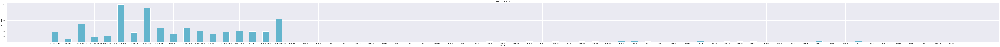

In [ ]:
feat_imp = skl_rfc.feature_importances_

plt.figure(figsize=( 69*1.8, 6  ))

index = np.arange(len(feature_names))

plt.bar(index, feat_imp, color='c', width=0.5)
plt.xlabel('features')
plt.ylabel('importance')
plt.title('Feature importance')
plt.xticks(index,feature_names)
plt.tight_layout()

plt.show()

Наиболее значимые признаки (указаны в порядке убывания значимости): Total day minutes, Total day charge, Customer service calls, International plan

## Градиентный бустинг

### AdaBoostClassifier

In [ ]:
from sklearn.ensemble import AdaBoostClassifier
skl_abc=AdaBoostClassifier(random_state=348)
skl_abc.fit(train_x,train_y)

AdaBoostClassifier(random_state=348)

In [ ]:
skl_abc_predicted=skl_abc.predict(test_x)
skl_abc.score(test_x,test_y)

0.8848580441640379

In [ ]:
skl_abc_probabilities = skl_abc.predict_proba(test_x )
roc_auc_score(test_y, skl_abc_probabilities[:,1] )

0.8765001113067412

In [ ]:
precision_score(test_y, skl_abc_predicted)

0.640625

In [ ]:
recall_score(test_y, skl_abc_predicted)

0.45054945054945056

0.8765001113067412

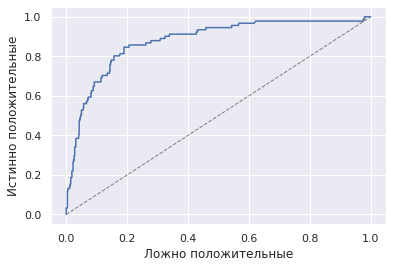

In [ ]:
sns.set()
from sklearn import metrics
from sklearn.metrics import roc_curve

fpr,tpr,_=roc_curve(test_y, skl_abc_probabilities[:,1])
plt.plot(fpr,tpr)
plt.plot([0,1],[0,1],color='grey', lw=1,linestyle='--')
plt.xlabel('Ложно положительные')
plt.ylabel('Истинно положительные')
metrics.auc(fpr,tpr)

In [ ]:
from sklearn.metrics import confusion_matrix
confusion_matrix(test_y, skl_abc_predicted)

array([[520,  23],
       [ 50,  41]])

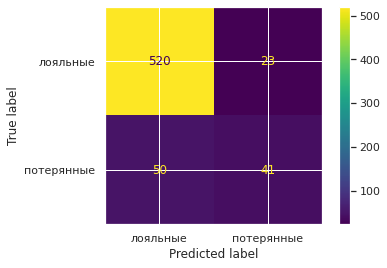

In [ ]:
disp=metrics.plot_confusion_matrix(skl_abc, test_x, test_y, values_format='n', display_labels=['лояльные', 'потерянные'])

In [ ]:
skl_abc_unseen=data_unseen_skl.copy(deep=True)
skl_abc_result=skl_abc.predict(data_unseen_)
skl_abc_unseen.insert(loc=18,column='Predicted', value=skl_abc_result)
#skl_abc_unseen.sort_values(by='Churn',ascending=False).head(22)
res_abc=skl_abc_unseen.where((skl_abc_unseen['Churn']==1)&(skl_abc_unseen['Predicted']==1)) #датасет с данными где предсказали прекращение контракта и это на самом деле случилось
res_abc=res_abc.dropna() 
res_abc.head(22) 

,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Predicted,Churn,State_AK,State_AL,State_AR,State_AZ,State_CA,State_CO,State_CT,State_DC,State_DE,State_FL,State_GA,State_HI,State_IA,State_ID,State_IL,State_IN,State_KS,State_KY,State_LA,State_MA,State_MD,State_ME,State_MI,State_MN,State_MO,State_MS,State_MT,State_NC,State_ND,State_NE,State_NH,State_NJ,State_NM,State_NV,State_NY,State_OH,State_OK,State_OR,State_PA,State_RI,State_SC,State_SD,State_TN,State_TX,State_UT,State_VA,State_VT,State_WA,State_WI,State_WV,State_WY
34,152.0,415.0,1.0,1.0,20.0,237.5,120.0,40.38,253.4,94.0,21.54,265.2,80.0,11.93,14.2,3.0,3.83,9.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
58,112.0,415.0,0.0,0.0,0.0,111.9,92.0,19.02,114.0,143.0,9.69,146.8,79.0,6.61,14.1,3.0,3.81,5.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
100,103.0,408.0,0.0,0.0,0.0,150.6,125.0,25.60,169.1,126.0,14.37,221.2,104.0,9.95,10.4,8.0,2.81,8.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
120,82.0,415.0,0.0,0.0,0.0,167.1,77.0,28.41,131.8,79.0,11.20,187.4,98.0,8.43,9.4,1.0,2.54,6.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
123,89.0,415.0,0.0,0.0,0.0,326.3,112.0,55.47,165.1,110.0,14.03,162.9,97.0,7.33,7.5,1.0,2.03,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
131,116.0,408.0,0.0,0.0,0.0,288.0,120.0,48.96,255.8,90.0,21.74,233.4,99.0,10.50,13.4,4.0,3.62,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


При применении модели AdaBoost из библиотеки Scikit-learn к новым данным 6 случаев из 22 были предсказаны верно

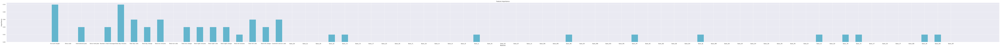

In [ ]:
feat_imp = skl_abc.feature_importances_

plt.figure(figsize=( 69*1.8, 6  ))

index = np.arange(len(feature_names))

plt.bar(index, feat_imp, color='c', width=0.5)
plt.xlabel('features')
plt.ylabel('importance')
plt.title('Feature importance')
plt.xticks(index,feature_names)
plt.tight_layout()

plt.show()

Наиболее значимые признаки (указаны в порядке убывания значимости): Account length, Total day minutes, Total day calls, Total day charge, Total eve charge, Total intl calls, Customer service calls

###GradientBoostingClassifier

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier
skl_gbc=GradientBoostingClassifier(random_state=348)
skl_gbc.fit(train_x,train_y)

GradientBoostingClassifier(random_state=348)

In [ ]:
skl_gbc_predicted=skl_gbc.predict(test_x)
skl_gbc.score(test_x,test_y)

0.9511041009463722

In [ ]:
skl_gbc_probabilities = skl_gbc.predict_proba(test_x )
roc_auc_score(test_y, skl_gbc_probabilities[:,1] )

0.9515916863983163

In [ ]:
precision_score(test_y, skl_gbc_predicted)

0.9054054054054054

In [ ]:
recall_score(test_y, skl_gbc_predicted)

0.7362637362637363

0.9515916863983163

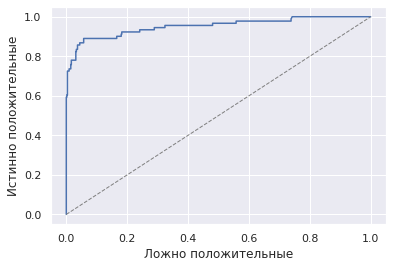

In [ ]:
sns.set()
from sklearn import metrics
from sklearn.metrics import roc_curve

fpr,tpr,_=roc_curve(test_y, skl_gbc_probabilities[:,1])
plt.plot(fpr,tpr)
plt.plot([0,1],[0,1],color='grey', lw=1,linestyle='--')
plt.xlabel('Ложно положительные')
plt.ylabel('Истинно положительные')
metrics.auc(fpr,tpr)

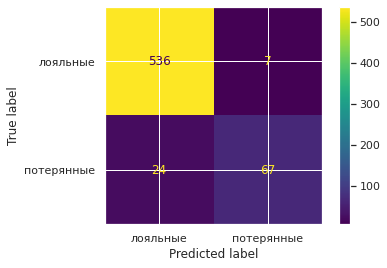

In [ ]:
disp=metrics.plot_confusion_matrix(skl_gbc, test_x, test_y, values_format='n', display_labels=['лояльные', 'потерянные'])

In [ ]:
skl_gbc_unseen=data_unseen_skl.copy(deep=True)
skl_gbc_result=skl_gbc.predict(data_unseen_)
skl_gbc_unseen.insert(loc=18,column='Predicted', value=skl_gbc_result)
#skl_gbc_unseen.sort_values(by='Churn',ascending=False).head(22)
res_gbc=skl_gbc_unseen.where((skl_gbc_unseen['Churn']==1)&(skl_gbc_unseen['Predicted']==1)) #датасет с данными где предсказали прекращение контракта и это на самом деле случилось
res_gbc=res_gbc.dropna() 
res_gbc.head(22) 

,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Predicted,Churn,State_AK,State_AL,State_AR,State_AZ,State_CA,State_CO,State_CT,State_DC,State_DE,State_FL,State_GA,State_HI,State_IA,State_ID,State_IL,State_IN,State_KS,State_KY,State_LA,State_MA,State_MD,State_ME,State_MI,State_MN,State_MO,State_MS,State_MT,State_NC,State_ND,State_NE,State_NH,State_NJ,State_NM,State_NV,State_NY,State_OH,State_OK,State_OR,State_PA,State_RI,State_SC,State_SD,State_TN,State_TX,State_UT,State_VA,State_VT,State_WA,State_WI,State_WV,State_WY
5,94.0,408.0,0.0,0.0,0.0,157.9,105.0,26.84,155.0,101.0,13.18,189.6,84.0,8.53,8.0,5.0,2.16,4.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
30,88.0,415.0,0.0,0.0,0.0,264.8,124.0,45.02,245.4,112.0,20.86,160.5,115.0,7.22,14.8,2.0,4.00,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
34,152.0,415.0,1.0,1.0,20.0,237.5,120.0,40.38,253.4,94.0,21.54,265.2,80.0,11.93,14.2,3.0,3.83,9.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
49,127.0,408.0,1.0,0.0,0.0,176.9,110.0,30.07,167.9,100.0,14.27,182.2,138.0,8.20,7.7,2.0,2.08,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
58,112.0,415.0,0.0,0.0,0.0,111.9,92.0,19.02,114.0,143.0,9.69,146.8,79.0,6.61,14.1,3.0,3.81,5.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
61,108.0,415.0,0.0,0.0,0.0,154.2,123.0,26.21,112.3,86.0,9.55,246.4,75.0,11.09,15.4,4.0,4.16,4.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
100,103.0,408.0,0.0,0.0,0.0,150.6,125.0,25.60,169.1,126.0,14.37,221.2,104.0,9.95,10.4,8.0,2.81,8.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
120,82.0,415.0,0.0,0.0,0.0,167.1,77.0,28.41,131.8,79.0,11.20,187.4,98.0,8.43,9.4,1.0,2.54,6.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
123,89.0,415.0,0.0,0.0,0.0,326.3,112.0,55.47,165.1,110.0,14.03,162.9,97.0,7.33,7.5,1.0,2.03,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
124,114.0,415.0,0.0,0.0,0.0,147.1,119.0,25.01,161.0,111.0,13.69,275.9,106.0,12.42,9.0,3.0,2.43,5.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


При применении модели GradientBoosting из библиотеки Scikit-learn к новым данным 15 случаев из 22 были предсказаны верно

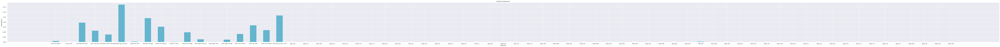

In [ ]:
feat_imp = skl_gbc.feature_importances_

plt.figure(figsize=( 69*1.8, 6  ))

index = np.arange(len(feature_names))

plt.bar(index, feat_imp, color='c', width=0.5)
plt.xlabel('features')
plt.ylabel('importance')
plt.title('Feature importance')
plt.xticks(index,feature_names)
plt.tight_layout()

plt.show()

Наиболее значимые признаки (указаны в порядке убывания значимости): Total day minutes, Customer service calls, Total day charge, International plan

#XGBoost

In [ ]:
import xgboost as xgb
from xgboost import XGBClassifier

from xgboost import plot_tree
import matplotlib.pyplot as plt
# plot single tree
xgbc= XGBClassifier(random_state=348)
xgbc_= XGBClassifier(random_state=348)
train_x_=train_x.copy(deep=True)
train_x_.rename(columns = lambda x: x.replace(' ', '_'), inplace=True)
xgbc.fit(train_x, train_y)


/usr/local/lib/python3.7/dist-packages/xgboost/sklearn.py:888: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[10:36:21] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=2, num_parallel_tree=1, random_state=348,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

/usr/local/lib/python3.7/dist-packages/xgboost/sklearn.py:888: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[10:47:41] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


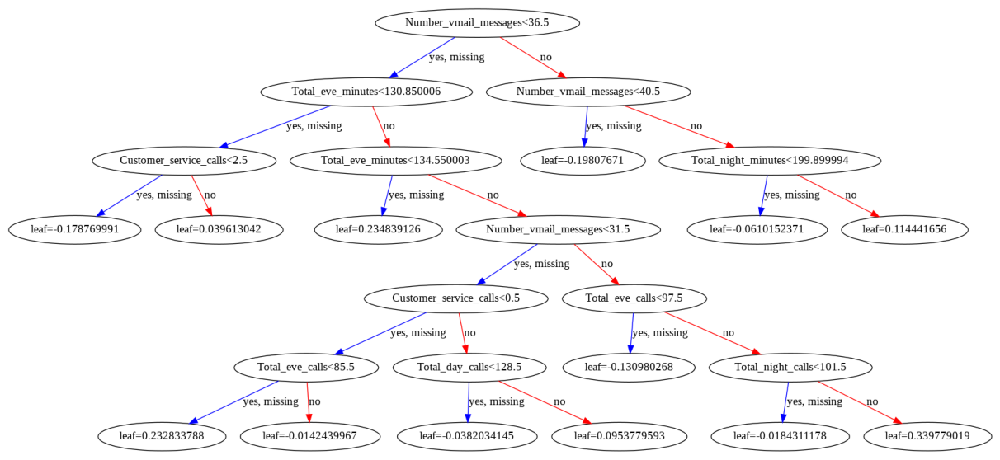

In [ ]:
plot_tree(xgbc_.fit(train_x_, train_y), num_trees=25)
plt.rcParams['figure.figsize'] = [50, 10]
plt.show()

In [ ]:
xgbc_predicted=xgbc.predict(test_x)
xgbc.score(test_x,test_y)

0.9511041009463722

In [ ]:
xgbc_probabilities = xgbc.predict_proba(test_x )
roc_auc_score(test_y, xgbc_probabilities[:,1] )

0.9428692854107219

In [ ]:
precision_score(test_y, xgbc_predicted)

0.9054054054054054

In [ ]:
recall_score(test_y, xgbc_predicted)

0.7362637362637363

0.9428692854107219

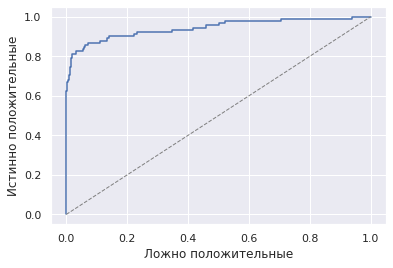

In [ ]:
sns.set()
from sklearn import metrics
from sklearn.metrics import roc_curve

fpr,tpr,_=roc_curve(test_y, xgbc_probabilities[:,1])
plt.rcParams['figure.figsize'] = [6, 4]
plt.plot(fpr,tpr)
plt.plot([0,1],[0,1],color='grey', lw=1,linestyle='--')
plt.xlabel('Ложно положительные')
plt.ylabel('Истинно положительные')
metrics.auc(fpr,tpr)

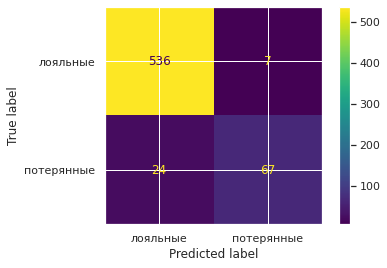

In [ ]:
disp=metrics.plot_confusion_matrix(xgbc, test_x, test_y, values_format='n', display_labels=['лояльные', 'потерянные'])

In [ ]:
xgbc_unseen=data_unseen_skl.copy(deep=True)
xgbc_result=xgbc.predict(data_unseen_)
xgbc_unseen.insert(loc=18,column='Predicted', value=xgbc_result)
#skl_gbc_unseen.sort_values(by='Churn',ascending=False).head(22)
res_xgbc=xgbc_unseen.where((xgbc_unseen['Churn']==1)&(xgbc_unseen['Predicted']==1)) #датасет с данными где предсказали прекращение контракта и это на самом деле случилось
res_xgbc=res_xgbc.dropna() 
res_xgbc.head(22) 

,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Predicted,Churn,State_AK,State_AL,State_AR,State_AZ,State_CA,State_CO,State_CT,State_DC,State_DE,State_FL,State_GA,State_HI,State_IA,State_ID,State_IL,State_IN,State_KS,State_KY,State_LA,State_MA,State_MD,State_ME,State_MI,State_MN,State_MO,State_MS,State_MT,State_NC,State_ND,State_NE,State_NH,State_NJ,State_NM,State_NV,State_NY,State_OH,State_OK,State_OR,State_PA,State_RI,State_SC,State_SD,State_TN,State_TX,State_UT,State_VA,State_VT,State_WA,State_WI,State_WV,State_WY
5,94.0,408.0,0.0,0.0,0.0,157.9,105.0,26.84,155.0,101.0,13.18,189.6,84.0,8.53,8.0,5.0,2.16,4.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
30,88.0,415.0,0.0,0.0,0.0,264.8,124.0,45.02,245.4,112.0,20.86,160.5,115.0,7.22,14.8,2.0,4.00,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
34,152.0,415.0,1.0,1.0,20.0,237.5,120.0,40.38,253.4,94.0,21.54,265.2,80.0,11.93,14.2,3.0,3.83,9.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
49,127.0,408.0,1.0,0.0,0.0,176.9,110.0,30.07,167.9,100.0,14.27,182.2,138.0,8.20,7.7,2.0,2.08,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
58,112.0,415.0,0.0,0.0,0.0,111.9,92.0,19.02,114.0,143.0,9.69,146.8,79.0,6.61,14.1,3.0,3.81,5.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
61,108.0,415.0,0.0,0.0,0.0,154.2,123.0,26.21,112.3,86.0,9.55,246.4,75.0,11.09,15.4,4.0,4.16,4.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
100,103.0,408.0,0.0,0.0,0.0,150.6,125.0,25.60,169.1,126.0,14.37,221.2,104.0,9.95,10.4,8.0,2.81,8.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
107,162.0,408.0,0.0,0.0,0.0,217.6,87.0,36.99,279.0,71.0,23.72,250.7,65.0,11.28,10.4,4.0,2.81,2.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
120,82.0,415.0,0.0,0.0,0.0,167.1,77.0,28.41,131.8,79.0,11.20,187.4,98.0,8.43,9.4,1.0,2.54,6.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
124,114.0,415.0,0.0,0.0,0.0,147.1,119.0,25.01,161.0,111.0,13.69,275.9,106.0,12.42,9.0,3.0,2.43,5.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


При применении модели XGBoost к новым данным 15 случаев из 22 были предсказаны верно

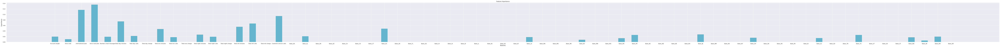

In [ ]:
feat_imp = xgbc.feature_importances_

plt.figure(figsize=( 69*1.8, 6  ))

index = np.arange(len(feature_names))

plt.bar(index, feat_imp, color='c', width=0.5)
plt.xlabel('features')
plt.ylabel('importance')
plt.title('Feature importance')
plt.xticks(index,feature_names)
plt.tight_layout()

plt.show()

Наиболее значимые признаки (указаны в порядке убывания значимости): Total day minutes, Customer service calls, Total intl minutes, Total intl call, International plan, Voice mail plan

#EDA ProfilReport

In [ ]:
!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip


In [ ]:
from pandas_profiling import ProfileReport
profile=ProfileReport(df, title="data_telecom", html={'style':{'full_width': True}})

In [ ]:
profile.to_file(output_file="telecom.html")

Summarize dataset:   0%|          | 0/33 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
profile.to_notebook_iframe()

#EDA DataPrep

In [ ]:
!pip install dataprep

DataPrep Report
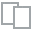
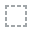
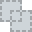
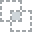
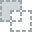
...
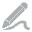
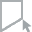
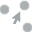
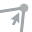
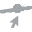

In [ ]:
from dataprep.eda import create_report
#df = load_dataset("train_data")
create_report(df)

#Выделяем данные для прогноза

In [ ]:
data = df.sample(frac=0.95, random_state=786)
data_unseen = df.drop(data.index)
data.reset_index(inplace=True, drop=True)
data_unseen.reset_index(inplace=True, drop=True)
print('Data for Modeling: ' + str(data.shape))
print('Unseen Data For Predictions: ' + str(data_unseen.shape))

Data for Modeling: (3166, 20)
Unseen Data For Predictions: (167, 20)


#AutoGluon

In [ ]:
!pip install -U pip
!pip install -U setuptools wheel
!pip install -U "mxnet<2.0.0"
!pip install autogluon

In [ ]:
from autogluon.tabular import TabularDataset, TabularPredictor

In [ ]:
#выделяем в датасете набора данных для обучения размером 2600 строк
train_data=data.sample(n=2600, random_state=348)
train_data.head()

,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn
2037,ND,84,510,No,No,0,226.9,144,38.57,201.6,122,17.14,130.2,121,5.86,13.2,5,3.56,2,False
1615,OH,127,408,No,No,0,139.6,94,23.73,240.9,112,20.48,127.1,88,5.72,8.8,4,2.38,2,False
140,SD,138,510,No,No,0,127.1,102,21.61,247.7,106,21.05,207.7,75,9.35,5.0,3,1.35,3,False
1985,UT,81,415,No,No,0,129.9,121,22.08,230.1,105,19.56,140.5,123,6.32,13.3,3,3.59,0,False
829,WY,43,415,Yes,No,0,251.5,105,42.76,212.8,104,18.09,157.8,67,7.10,9.3,4,2.51,0,False


In [ ]:
label = 'Churn'
print("Summary of Churn variable: \n", train_data[label].describe())

Summary of Churn variable: 
 count      2600
unique        2
top       False
freq       2218
Name: Churn, dtype: object


In [ ]:
save_path = 'agModels-predictClass_Telecom'  # здесь сохраняем обучаемую модель
predictor_ag = TabularPredictor(label='Churn', path=save_path ).fit(train_data,  )

Beginning AutoGluon training ...
AutoGluon will save models to "agModels-predictClass_Telecom/"
AutoGluon Version:  0.2.0
Train Data Rows:    2600
Train Data Columns: 19
Preprocessing data ...
AutoGluon infers your prediction problem is: 'binary' (because only two unique label-values observed).
	2 unique label values:  [False, True]
	If 'binary' is not the correct problem_type, please manually specify the problem_type argument in fit() (You may specify problem_type as one of: ['binary', 'multiclass', 'regression'])
Selected class <--> label mapping:  class 1 = True, class 0 = False
Using Feature Generators to preprocess the data ...
Fitting AutoMLPipelineFeatureGenerator...
	Available Memory:                    12703.67 MB
	Train Data (Original)  Memory Usage: 0.79 MB (0.0% of available memory)
	Inferring data type of each feature based on column values. Set feature_metadata_in to manually specify special dtypes of the features.
	Stage 1 Generators:
		Fitting AsTypeFeatureGenerator...


In [ ]:
test_data=data.sample(n=400, random_state=85)
test_data.head()
y_test = test_data[label]  # значения, которые будем предсказывать
test_data_nolab = test_data.drop(columns=[label])  # удаляем столбец с искомыми данными
test_data_nolab.head()

,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls
703,MS,76,408,No,No,0,173.2,93,29.44,131.2,80,11.15,170.9,104,7.69,5.4,3,1.46,0
959,PA,88,510,No,No,0,218.2,76,37.09,169.3,60,14.39,141.1,99,6.35,8.0,1,2.16,1
1691,TX,98,408,No,Yes,19,110.5,87,18.79,227.8,97,19.36,243.6,84,10.96,11.0,4,2.97,1
2236,NV,76,510,Yes,No,0,241.0,120,40.97,231.8,96,19.70,220.2,67,9.91,9.9,1,2.67,1
488,SC,102,408,No,No,0,174.5,73,29.67,213.7,114,18.16,164.7,116,7.41,10.3,5,2.78,4


In [ ]:
#predictor = TabularPredictor.load(save_path)  # так можно загрузить из файла модель, которую мы обучали
y_pred = predictor_ag.predict(test_data_nolab)
print("Predictions:  \n", y_pred)

Predictions:  
 703     False
959     False
1691    False
2236     True
488     False
        ...  
216     False
2220    False
1006    False
1215    False
1597    False
Name: Churn, Length: 400, dtype: bool


In [ ]:
perf =predictor_ag.evaluate(test_data) #выводит метрики для модели, считающейся лучшей (в данном случае это WeightedEnsemble_L2)

Evaluation: accuracy on test data: 0.9875
Evaluations on test data:
{
    "accuracy": 0.9875,
    "balanced_accuracy": 0.959016393442623,
    "mcc": 0.9511515584153071,
    "roc_auc": 0.9970017892547995,
    "f1": 0.9572649572649572,
    "precision": 1.0,
    "recall": 0.9180327868852459
}


In [ ]:
perf_ag_WE12 =predictor_ag.evaluate(test_data,model='WeightedEnsemble_L2')

Evaluation: accuracy on test data: 0.9875
Evaluations on test data:
{
    "accuracy": 0.9875,
    "balanced_accuracy": 0.959016393442623,
    "mcc": 0.9511515584153071,
    "roc_auc": 0.9970017892547995,
    "f1": 0.9572649572649572,
    "precision": 1.0,
    "recall": 0.9180327868852459
}


In [ ]:
perf_ag_XGB =predictor_ag.evaluate(test_data,model='XGBoost')

Evaluation: accuracy on test data: 0.9875
Evaluations on test data:
{
    "accuracy": 0.9875,
    "balanced_accuracy": 0.959016393442623,
    "mcc": 0.9511515584153071,
    "roc_auc": 0.995067459741767,
    "f1": 0.9572649572649572,
    "precision": 1.0,
    "recall": 0.9180327868852459
}


In [ ]:
perf_ag_CB =predictor_ag.evaluate(test_data,model='CatBoost')

Evaluation: accuracy on test data: 0.9875
Evaluations on test data:
{
    "accuracy": 0.9875,
    "balanced_accuracy": 0.959016393442623,
    "mcc": 0.9511515584153071,
    "roc_auc": 0.9933749214178635,
    "f1": 0.9572649572649572,
    "precision": 1.0,
    "recall": 0.9180327868852459
}


In [ ]:
perf_ag_LGB =predictor_ag.evaluate(test_data,model='LightGBM')

Evaluation: accuracy on test data: 0.99
Evaluations on test data:
{
    "accuracy": 0.99,
    "balanced_accuracy": 0.9806567048696746,
    "mcc": 0.9613134097393491,
    "roc_auc": 0.997678804584361,
    "f1": 0.9672131147540983,
    "precision": 0.9672131147540983,
    "recall": 0.9672131147540983
}


In [ ]:
predictor_ag.leaderboard(test_data) #список моделей, полученных на тестовых данных, виде pd.DataFrame. Включает информацию о результатах тестирования и валидации для всех моделей, времени обучения модели, времени вывода и уровнях стека

                  model  score_test  score_val  pred_time_test  pred_time_val   fit_time  pred_time_test_marginal  pred_time_val_marginal  fit_time_marginal  stack_level  can_infer  fit_order
0      RandomForestGini      0.9975      0.958        0.124674       0.108704   1.566455                 0.124674                0.108704           1.566455            1       True          5
1      RandomForestEntr      0.9950      0.952        0.122238       0.108197   1.883485                 0.122238                0.108197           1.883485            1       True          6
2         LightGBMLarge      0.9925      0.966        0.051899       0.024004   2.329991                 0.051899                0.024004           2.329991            1       True         13
3              LightGBM      0.9900      0.966        0.021426       0.017705   0.749295                 0.021426                0.017705           0.749295            1       True          4
4              CatBoost      0.9875     

,model,score_test,score_val,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,RandomForestGini,0.9975,0.958,0.124674,0.108704,1.566455,0.124674,0.108704,1.566455,1,True,5
1,RandomForestEntr,0.9950,0.952,0.122238,0.108197,1.883485,0.122238,0.108197,1.883485,1,True,6
2,LightGBMLarge,0.9925,0.966,0.051899,0.024004,2.329991,0.051899,0.024004,2.329991,1,True,13
3,LightGBM,0.9900,0.966,0.021426,0.017705,0.749295,0.021426,0.017705,0.749295,1,True,4
4,CatBoost,0.9875,0.966,0.010949,0.006931,2.034316,0.010949,0.006931,2.034316,1,True,7
5,XGBoost,0.9875,0.964,0.050113,0.013971,1.527590,0.050113,0.013971,1.527590,1,True,11
6,WeightedEnsemble_L2,0.9875,0.968,0.056947,0.043887,4.377024,0.005082,0.001531,0.654871,2,True,14
7,LightGBMXT,0.9775,0.952,0.019490,0.017720,0.938542,0.019490,0.017720,0.938542,1,True,3
8,ExtraTreesEntr,0.9775,0.914,0.239200,0.208818,0.971305,0.239200,0.208818,0.971305,1,True,9
9,ExtraTreesGini,0.9725,0.918,0.232424,0.209360,0.959778,0.232424,0.209360,0.959778,1,True,8


In [ ]:
predictor_ag.fit_summary() #сводка информации о моделях, созданных во время fit ()

*** Summary of fit() ***
Estimated performance of each model:
                  model  score_val  pred_time_val   fit_time  pred_time_val_marginal  fit_time_marginal  stack_level  can_infer  fit_order
0   WeightedEnsemble_L2      0.968       0.043887   4.377024                0.001531           0.654871            2       True         14
1              CatBoost      0.966       0.006931   2.034316                0.006931           2.034316            1       True          7
2              LightGBM      0.966       0.017705   0.749295                0.017705           0.749295            1       True          4
3         LightGBMLarge      0.966       0.024004   2.329991                0.024004           2.329991            1       True         13
4               XGBoost      0.964       0.013971   1.527590                0.013971           1.527590            1       True         11
5      RandomForestGini      0.958       0.108704   1.566455                0.108704           1.566455 

{'leaderboard':                   model  score_val  ...  can_infer  fit_order
 0   WeightedEnsemble_L2      0.968  ...       True         14
 1              CatBoost      0.966  ...       True          7
 2              LightGBM      0.966  ...       True          4
 3         LightGBMLarge      0.966  ...       True         13
 4               XGBoost      0.964  ...       True         11
 5      RandomForestGini      0.958  ...       True          5
 6            LightGBMXT      0.952  ...       True          3
 7      RandomForestEntr      0.952  ...       True          6
 8       NeuralNetFastAI      0.920  ...       True         10
 9        ExtraTreesGini      0.918  ...       True          8
 10       ExtraTreesEntr      0.914  ...       True          9
 11       NeuralNetMXNet      0.908  ...       True         12
 12       KNeighborsDist      0.860  ...       True          2
 13       KNeighborsUnif      0.860  ...       True          1
 
 [14 rows x 9 columns],
 'max_stack_le

In [ ]:
predictor_ag.feature_importance(test_data) #важные признаки

Computing feature importance via permutation shuffling for 19 features using 400 rows with 3 shuffle sets...
	4.68s	= Expected runtime (1.56s per shuffle set)
	0.99s	= Actual runtime (Completed 3 of 3 shuffle sets)


,importance,stddev,p_value,n,p99_high,p99_low
Total day minutes,0.087500,0.005000,0.000543,3,0.116151,0.058849
Customer service calls,0.052500,0.004330,0.001130,3,0.077312,0.027688
International plan,0.051667,0.001443,0.000130,3,0.059937,0.043396
Total eve minutes,0.033333,0.006292,0.005834,3,0.069384,-0.002718
Total intl calls,0.023333,0.008036,0.018670,3,0.069383,-0.022716
Total day charge,0.020833,0.003819,0.005508,3,0.042716,-0.001049
Voice mail plan,0.019167,0.003819,0.006488,3,0.041049,-0.002716
Total intl minutes,0.016667,0.002887,0.004926,3,0.033208,0.000125
Total eve charge,0.009167,0.005204,0.046368,3,0.038987,-0.020654
Total night minutes,0.006667,0.001443,0.007634,3,0.014937,-0.001604


In [ ]:
predictor_ag.get_model_names()

['KNeighborsUnif',
 'KNeighborsDist',
 'LightGBMXT',
 'LightGBM',
 'RandomForestGini',
 'RandomForestEntr',
 'CatBoost',
 'ExtraTreesGini',
 'ExtraTreesEntr',
 'NeuralNetFastAI',
 'XGBoost',
 'NeuralNetMXNet',
 'LightGBMLarge',
 'WeightedEnsemble_L2']

In [ ]:
i = 0  # выбираем какую модель использовать по индексу в датафрейме
model_to_use = predictor_ag.get_model_names()[i]
model_pred = predictor_ag.predict(test_data, model=model_to_use)
print("Prediction from %s model: %s" % (model_to_use, model_pred.iloc[0]))

Prediction from KNeighborsUnif model: False


In [ ]:
specific_model = predictor_ag._trainer.load_model(model_to_use)
model_info = specific_model.get_info()
model_info

{'ag_args_fit': {'get_features_kwargs': None,
  'get_features_kwargs_extra': None,
  'ignored_type_group_raw': ['category', 'object'],
  'ignored_type_group_special': ['text_ngram',
   'text_special',
   'datetime_as_int'],
  'max_memory_usage_ratio': 1.0,
  'max_time_limit': None,
  'max_time_limit_ratio': 1.0,
  'min_time_limit': 0},
 'eval_metric': 'accuracy',
 'feature_metadata': <autogluon.core.features.feature_metadata.FeatureMetadata at 0x7f336eb0ea10>,
 'features': ['Account length',
  'Area code',
  'Number vmail messages',
  'Total day minutes',
  'Total day calls',
  'Total day charge',
  'Total eve minutes',
  'Total eve calls',
  'Total eve charge',
  'Total night minutes',
  'Total night calls',
  'Total night charge',
  'Total intl minutes',
  'Total intl calls',
  'Total intl charge',
  'Customer service calls'],
 'fit_time': 0.015007495880126953,
 'hyperparameters': {'n_jobs': -1, 'weights': 'uniform'},
 'hyperparameters_fit': {},
 'hyperparameters_nondefault': ['weigh

In [ ]:
predictor_ag.info( )

{'best_model': 'WeightedEnsemble_L2',
 'best_model_score_val': 0.968,
 'best_model_stack_level': 2,
 'eval_metric': 'accuracy',
 'label': 'Churn',
 'max_core_stack_level': 1,
 'max_stack_level': 2,
 'model_info': {'CatBoost': {'ag_args_fit': {'get_features_kwargs': None,
    'get_features_kwargs_extra': None,
    'ignored_type_group_raw': ['object'],
    'ignored_type_group_special': None,
    'max_memory_usage_ratio': 1.0,
    'max_time_limit': None,
    'max_time_limit_ratio': 1.0,
    'min_time_limit': 0},
   'eval_metric': 'accuracy',
   'feature_metadata': <autogluon.core.features.feature_metadata.FeatureMetadata at 0x7f336c0412d0>,
   'features': ['Account length',
    'Area code',
    'Number vmail messages',
    'Total day minutes',
    'Total day calls',
    'Total day charge',
    'Total eve minutes',
    'Total eve calls',
    'Total eve charge',
    'Total night minutes',
    'Total night calls',
    'Total night charge',
    'Total intl minutes',
    'Total intl calls',
  

In [ ]:
y_unseen = data_unseen[label]  # значения, которые будем предсказывать
data_unseen_nolab = data_unseen.drop(columns=[label])  # удаляем столбец с искомыми данными
data_unseen_nolab.head()

,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls
0,AL,118,510,Yes,No,0,223.4,98,37.98,220.6,101,18.75,203.9,118,9.18,6.3,6,1.70,0
1,MT,95,510,No,No,0,156.6,88,26.62,247.6,75,21.05,192.3,115,8.65,12.3,5,3.32,3
2,VT,93,510,No,No,0,190.7,114,32.42,218.2,111,18.55,129.6,121,5.83,8.1,3,2.19,3
3,CO,121,408,No,Yes,30,198.4,129,33.73,75.3,77,6.40,181.2,77,8.15,5.8,3,1.57,3
4,GA,70,415,No,Yes,24,249.5,101,42.42,259.7,98,22.07,222.7,68,10.02,9.8,4,2.65,1


In [ ]:
model_to_use='XGBoost'
ag_pred_y_unseen = predictor_ag.predict(data_unseen_nolab, model=model_to_use)
print("Predictions:  \n", ag_pred_y_unseen)

Predictions:  
 0      False
1      False
2      False
3      False
4      False
       ...  
162     True
163    False
164     True
165    False
166    False
Name: Churn, Length: 167, dtype: bool


In [ ]:
data_unseen_ag=data_unseen.copy(deep=True)
data_unseen_ag.insert(loc=19,column='Predicted', value=ag_pred_y_unseen)
#data_unseen_ag.sort_values(by='Churn',ascending=False).head(22)
res_ag=data_unseen_ag.where((data_unseen_ag['Churn']==True)&(data_unseen_ag['Predicted']==True)) #датасет с данными где предсказали прекращение контракта и это на самом деле случилось
res_ag=res_ag.dropna() 
res_ag.head(22) 

,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Predicted,Churn
5,IN,94.0,408.0,No,No,0.0,157.9,105.0,26.84,155.0,101.0,13.18,189.6,84.0,8.53,8.0,5.0,2.16,4.0,1.0,1.0
30,MA,88.0,415.0,No,No,0.0,264.8,124.0,45.02,245.4,112.0,20.86,160.5,115.0,7.22,14.8,2.0,4.00,1.0,1.0,1.0
34,MN,152.0,415.0,Yes,Yes,20.0,237.5,120.0,40.38,253.4,94.0,21.54,265.2,80.0,11.93,14.2,3.0,3.83,9.0,1.0,1.0
49,MA,127.0,408.0,Yes,No,0.0,176.9,110.0,30.07,167.9,100.0,14.27,182.2,138.0,8.20,7.7,2.0,2.08,1.0,1.0,1.0
58,CA,112.0,415.0,No,No,0.0,111.9,92.0,19.02,114.0,143.0,9.69,146.8,79.0,6.61,14.1,3.0,3.81,5.0,1.0,1.0
61,NY,108.0,415.0,No,No,0.0,154.2,123.0,26.21,112.3,86.0,9.55,246.4,75.0,11.09,15.4,4.0,4.16,4.0,1.0,1.0
100,NH,103.0,408.0,No,No,0.0,150.6,125.0,25.60,169.1,126.0,14.37,221.2,104.0,9.95,10.4,8.0,2.81,8.0,1.0,1.0
120,NY,82.0,415.0,No,No,0.0,167.1,77.0,28.41,131.8,79.0,11.20,187.4,98.0,8.43,9.4,1.0,2.54,6.0,1.0,1.0
123,WI,89.0,415.0,No,No,0.0,326.3,112.0,55.47,165.1,110.0,14.03,162.9,97.0,7.33,7.5,1.0,2.03,1.0,1.0,1.0
124,DC,114.0,415.0,No,No,0.0,147.1,119.0,25.01,161.0,111.0,13.69,275.9,106.0,12.42,9.0,3.0,2.43,5.0,1.0,1.0


При обучении моделей с помощью бибилиотеки AutoGluon из 22 отказов правильно были предсказаны:<br>
14 в модели WeightedEnsemble_L2<br>
16 в модели XGBoost<br>
14 в модели CatBoost<br>
15 в модели LightGBM

#PyCaret

In [ ]:
from google.colab import drive
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
% matplotlib inline
import math

In [ ]:
!pip install pycaret

In [ ]:
from pycaret.utils import enable_colab
enable_colab()

Colab mode enabled.


In [ ]:
from pycaret.classification import *

In [ ]:
init_pycaret = setup(data = data, target = 'Churn', session_id=348) #инициализирует среду в pycaret

,Description,Value
0,session_id,348
1,Target,Churn
2,Target Type,Binary
3,Label Encoded,"False: 0, True: 1"
4,Original Data,"(3166, 20)"
5,Missing Values,False
6,Numeric Features,13
7,Categorical Features,6
8,Ordinal Features,False
9,High Cardinality Features,False


create_model_container: 0
master_model_container: 0
display_container: 1
Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=[],
                                      display_types=True, features_todrop=[],
                                      id_columns=[],
                                      ml_usecase='classification',
                                      numerical_features=[], target='Churn',
                                      time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value_categorical=None,
                                fill_value_numerical=None,
                                numeric_strate...
                ('scaling', 'passthrough'), ('P_transform', 'passthrough'),
                ('binn', 'passthrough'), ('rem_outliers', 'passthrough'),
                ('cluster_all', 'passthrough'),
                

In [ ]:
best_model = compare_models(sort='Accuracy') #выбираем лучшую модель по метрике Accuracy

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
catboost,CatBoost Classifier,0.9504,0.9248,0.7363,0.9364,0.8221,0.7939,0.8029,4.743
xgboost,Extreme Gradient Boosting,0.9440,0.9143,0.7076,0.9191,0.7974,0.7658,0.7758,3.013
gbc,Gradient Boosting Classifier,0.9431,0.9141,0.7132,0.9073,0.7972,0.7648,0.7731,0.580
lightgbm,Light Gradient Boosting Machine,0.9382,0.9119,0.6647,0.9241,0.7693,0.7351,0.7505,0.211
dt,Decision Tree Classifier,0.9098,0.8368,0.7303,0.7118,0.7186,0.6650,0.6666,0.050
rf,Random Forest Classifier,0.9075,0.9113,0.4552,0.9105,0.6047,0.5594,0.6036,0.699
et,Extra Trees Classifier,0.8876,0.8980,0.3581,0.8423,0.4998,0.4480,0.5015,0.632
ada,Ada Boost Classifier,0.8736,0.8484,0.4266,0.6614,0.5135,0.4453,0.4621,0.231
ridge,Ridge Classifier,0.8587,0.0000,0.3036,0.6017,0.4018,0.3319,0.3576,0.022
lr,Logistic Regression,0.8583,0.8540,0.3150,0.5918,0.4093,0.3379,0.3603,0.875


create_model_container: 15
master_model_container: 15
display_container: 2
compare_models() succesfully completed......................................


In [ ]:
print(best_model)

In [ ]:
models() #список всех моделей

gpu_param set to False


,Name,Reference,Turbo
ID,,,
lr,Logistic Regression,sklearn.linear_model._logistic.LogisticRegression,True
knn,K Neighbors Classifier,sklearn.neighbors._classification.KNeighborsClassifier,True
nb,Naive Bayes,sklearn.naive_bayes.GaussianNB,True
dt,Decision Tree Classifier,sklearn.tree._classes.DecisionTreeClassifier,True
svm,SVM - Linear Kernel,sklearn.linear_model._stochastic_gradient.SGDClassifier,True
rbfsvm,SVM - Radial Kernel,sklearn.svm._classes.SVC,False
gpc,Gaussian Process Classifier,sklearn.gaussian_process._gpc.GaussianProcessClassifier,False
mlp,MLP Classifier,sklearn.neural_network._multilayer_perceptron.MLPClassifier,False
ridge,Ridge Classifier,sklearn.linear_model._ridge.RidgeClassifier,True


In [ ]:
dt_pycaret = create_model('dt') #загружаем в переменну. dt модель дерева решений

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9099,0.8420,0.7429,0.7027,0.7222,0.6685,0.6689
1,0.9099,0.8420,0.7429,0.7027,0.7222,0.6685,0.6689
2,0.8964,0.8572,0.8000,0.6364,0.7089,0.6468,0.6531
3,0.9414,0.8956,0.8286,0.8056,0.8169,0.7821,0.7822
4,0.8964,0.8456,0.7714,0.6429,0.7013,0.6393,0.6431
5,0.8919,0.7965,0.6571,0.6571,0.6571,0.5930,0.5930
6,0.8733,0.7567,0.5882,0.5882,0.5882,0.5134,0.5134
7,0.9186,0.8124,0.6571,0.7931,0.7188,0.6716,0.6757
8,0.9095,0.8303,0.7143,0.7143,0.7143,0.6605,0.6605
9,0.9502,0.8892,0.8000,0.8750,0.8358,0.8066,0.8077


create_model_container: 16
master_model_container: 16
display_container: 3
DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=348, splitter='best')
create_model() succesfully completed......................................


In [ ]:
knn_pycaret = create_model('knn') #К ближайших соседей

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8243,0.5539,0.2000,0.3889,0.2642,0.1759,0.1885
1,0.8559,0.6079,0.1429,0.7143,0.2381,0.1958,0.2756
2,0.8423,0.5967,0.1143,0.5000,0.1860,0.1353,0.1816
3,0.8468,0.6727,0.1714,0.5455,0.2609,0.2006,0.2430
4,0.8514,0.6354,0.2571,0.5625,0.3529,0.2819,0.3096
5,0.8468,0.6050,0.2286,0.5333,0.3200,0.2490,0.2775
6,0.8235,0.6229,0.2059,0.3684,0.2642,0.1729,0.1824
7,0.8643,0.6145,0.2286,0.7273,0.3478,0.2944,0.3566
8,0.8462,0.6229,0.2286,0.5333,0.3200,0.2486,0.2771
9,0.8914,0.6558,0.3429,0.9231,0.5000,0.4531,0.5236


create_model_container: 17
master_model_container: 17
display_container: 4
KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=-1, n_neighbors=5, p=2,
                     weights='uniform')
create_model() succesfully completed......................................


In [ ]:
rf_pycaret = create_model('rf') #случайный лес

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9099,0.8860,0.4857,0.8947,0.6296,0.5834,0.6188
1,0.8874,0.9400,0.3714,0.8125,0.5098,0.4560,0.5008
2,0.9144,0.9173,0.5143,0.9000,0.6545,0.6098,0.6410
3,0.9279,0.9583,0.5714,0.9524,0.7143,0.6760,0.7049
4,0.8964,0.9351,0.4000,0.8750,0.5490,0.4995,0.5486
5,0.9054,0.9019,0.4286,0.9375,0.5882,0.5430,0.5964
6,0.8778,0.8584,0.3235,0.7333,0.4490,0.3917,0.4334
7,0.9050,0.8215,0.4000,1.0000,0.5714,0.5288,0.5995
8,0.9186,0.9400,0.4857,1.0000,0.6538,0.6139,0.6655
9,0.9321,0.9549,0.5714,1.0000,0.7273,0.6918,0.7272


create_model_container: 18
master_model_container: 18
display_container: 5
RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=-1, oob_score=False, random_state=348, verbose=0,
                       warm_start=False)
create_model() succesfully completed......................................


In [ ]:
xgb_pycaret = create_model('xgboost')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9459,0.9216,0.7143,0.9259,0.8065,0.7756,0.7845
1,0.9505,0.9271,0.7143,0.9615,0.8197,0.7917,0.8034
2,0.9685,0.9352,0.8000,1.0000,0.8889,0.8708,0.8781
3,0.9505,0.9421,0.7429,0.9286,0.8254,0.7969,0.8037
4,0.9234,0.9354,0.6571,0.8214,0.7302,0.6862,0.6920
5,0.9324,0.8920,0.6571,0.8846,0.7541,0.7159,0.7266
6,0.9276,0.8529,0.6471,0.8462,0.7333,0.6923,0.7006
7,0.9276,0.8519,0.5714,0.9524,0.7143,0.6758,0.7047
8,0.9502,0.9412,0.7143,0.9615,0.8197,0.7915,0.8033
9,0.9638,0.9439,0.8571,0.9091,0.8824,0.8610,0.8615


create_model_container: 19
master_model_container: 19
display_container: 6
XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=-1, num_parallel_tree=1,
              objective='binary:logistic', random_state=348, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method='auto',
              use_label_encoder=True, validate_parameters=1, verbosity=0)
create_model() succesfully completed......................................


In [ ]:
lgbm_pycaret = create_model('lightgbm')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9324,0.9334,0.6286,0.9167,0.7458,0.7084,0.7251
1,0.9505,0.9322,0.7143,0.9615,0.8197,0.7917,0.8034
2,0.9640,0.9465,0.8000,0.9655,0.8750,0.8542,0.8593
3,0.9369,0.9572,0.6857,0.8889,0.7742,0.7383,0.7467
4,0.9234,0.8970,0.6571,0.8214,0.7302,0.6862,0.6920
5,0.9369,0.9105,0.6000,1.0000,0.7500,0.7165,0.7471
6,0.9186,0.8402,0.6471,0.7857,0.7097,0.6628,0.6671
7,0.9140,0.8184,0.4857,0.9444,0.6415,0.5983,0.6411
8,0.9367,0.9475,0.6286,0.9565,0.7586,0.7239,0.7451
9,0.9683,0.9359,0.8000,1.0000,0.8889,0.8707,0.8781


create_model_container: 20
master_model_container: 20
display_container: 7
LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=348, reg_alpha=0.0, reg_lambda=0.0, silent=True,
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0)
create_model() succesfully completed......................................


In [ ]:
cb_pycaret = create_model('catboost')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9459,0.9335,0.6857,0.9600,0.8000,0.7697,0.7843
1,0.9369,0.9337,0.6857,0.8889,0.7742,0.7383,0.7467
2,0.9550,0.9288,0.8000,0.9032,0.8485,0.8221,0.8242
3,0.9640,0.9522,0.8000,0.9655,0.8750,0.8542,0.8593
4,0.9550,0.9283,0.7714,0.9310,0.8438,0.8177,0.8226
5,0.9550,0.9131,0.8000,0.9032,0.8485,0.8221,0.8242
6,0.9367,0.9037,0.7059,0.8571,0.7742,0.7378,0.7425
7,0.9321,0.8253,0.6000,0.9545,0.7368,0.7002,0.7251
8,0.9502,0.9705,0.6857,1.0000,0.8136,0.7860,0.8046
9,0.9729,0.9590,0.8286,1.0000,0.9062,0.8905,0.8959


create_model_container: 21
master_model_container: 21
display_container: 8
create_model() succesfully completed......................................


In [ ]:
tuned_dt_pycaret = tune_model(dt_pycaret) #функция автоматически настраивает гиперпараметры модели, используя «Случайный поиск по сетке» в заранее заданном пространстве поиска

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9144,0.8545,0.6857,0.7500,0.7164,0.6661,0.6671
1,0.9414,0.9105,0.7714,0.8438,0.8060,0.7716,0.7726
2,0.9595,0.9345,0.8857,0.8611,0.8732,0.8491,0.8492
3,0.9640,0.8451,0.8000,0.9655,0.8750,0.8542,0.8593
4,0.9189,0.8086,0.6857,0.7742,0.7273,0.6799,0.6816
5,0.9369,0.8199,0.7143,0.8621,0.7813,0.7448,0.7493
6,0.8869,0.8287,0.6176,0.6364,0.6269,0.5602,0.5603
7,0.9367,0.8343,0.6000,1.0000,0.7500,0.7163,0.7470
8,0.9548,0.8641,0.7714,0.9310,0.8438,0.8176,0.8225
9,0.9638,0.8925,0.8286,0.9355,0.8788,0.8576,0.8598


create_model_container: 22
master_model_container: 22
display_container: 9
DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=12, max_features=1.0, max_leaf_nodes=None,
                       min_impurity_decrease=0, min_impurity_split=None,
                       min_samples_leaf=3, min_samples_split=5,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=348, splitter='best')
tune_model() succesfully completed......................................


In [ ]:
tuned_knn_pycaret = tune_model(knn_pycaret, custom_grid = {'n_neighbors' : np.arange(0,50,1)})

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8468,0.6101,0.1429,0.5556,0.2273,0.1740,0.2244
1,0.8604,0.6827,0.1429,0.8333,0.2439,0.2073,0.3090
2,0.8514,0.6032,0.0571,1.0000,0.1081,0.0926,0.2204
3,0.8514,0.6646,0.0857,0.7500,0.1538,0.1256,0.2202
4,0.8694,0.7255,0.2286,0.8000,0.3556,0.3070,0.3828
5,0.8694,0.6977,0.1714,1.0000,0.2927,0.2585,0.3852
6,0.8507,0.6934,0.1176,0.5714,0.1951,0.1505,0.2093
7,0.8643,0.6083,0.2000,0.7778,0.3182,0.2709,0.3496
8,0.8643,0.7451,0.1714,0.8571,0.2857,0.2459,0.3462
9,0.8733,0.7066,0.2000,1.0000,0.3333,0.2962,0.4169


create_model_container: 23
master_model_container: 23
display_container: 10
KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=-1, n_neighbors=35, p=2,
                     weights='uniform')
tune_model() succesfully completed......................................


In [ ]:
tuned_rf_pycaret = tune_model(rf_pycaret)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8514,0.8875,0.7143,0.5208,0.6024,0.5137,0.5234
1,0.8829,0.9044,0.7429,0.6047,0.6667,0.5965,0.6012
2,0.8784,0.8909,0.8286,0.5800,0.6824,0.6100,0.6249
3,0.8559,0.8882,0.8000,0.5283,0.6364,0.5511,0.5696
4,0.8784,0.8483,0.7429,0.5909,0.6582,0.5854,0.5911
5,0.9054,0.8857,0.8000,0.6667,0.7273,0.6706,0.6747
6,0.8326,0.8172,0.7353,0.4717,0.5747,0.4766,0.4948
7,0.8597,0.8108,0.6286,0.5500,0.5867,0.5026,0.5043
8,0.8733,0.8989,0.7714,0.5745,0.6585,0.5828,0.5923
9,0.8643,0.9189,0.8286,0.5472,0.6591,0.5787,0.5981


create_model_container: 24
master_model_container: 24
display_container: 11
RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=4, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0005, min_impurity_split=None,
                       min_samples_leaf=3, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=200,
                       n_jobs=-1, oob_score=False, random_state=348, verbose=0,
                       warm_start=False)
tune_model() succesfully completed......................................


In [ ]:
tuned_xgb_pycaret = tune_model(xgb_pycaret, n_iter=3) #средние значения метрик получились хуже чем у обычной модели xgboost

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9505,0.9379,0.8286,0.8529,0.8406,0.8113,0.8114
1,0.9279,0.9176,0.8000,0.7568,0.7778,0.7348,0.7352
2,0.9369,0.9265,0.8286,0.7838,0.8056,0.7680,0.7684
3,0.9189,0.8794,0.6857,0.7742,0.7273,0.6799,0.6816
4,0.9324,0.9202,0.8000,0.7778,0.7887,0.7485,0.7486
5,0.9324,0.9087,0.8286,0.7632,0.7945,0.7542,0.7551
6,0.8733,0.8580,0.7353,0.5682,0.6410,0.5656,0.5726
7,0.8959,0.8320,0.6286,0.6875,0.6567,0.5955,0.5964
8,0.9140,0.9421,0.7143,0.7353,0.7246,0.6737,0.6738
9,0.9186,0.9661,0.8571,0.6977,0.7692,0.7204,0.7260


create_model_container: 25
master_model_container: 25
display_container: 12
XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.0005, max_delta_step=0, max_depth=7,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=60, n_jobs=-1, num_parallel_tree=1,
              objective='binary:logistic', random_state=348, reg_alpha=0.01,
              reg_lambda=0.4, scale_pos_weight=8.8, subsample=0.5,
              tree_method='auto', use_label_encoder=True, validate_parameters=1,
              verbosity=0)
tune_model() succesfully completed......................................


In [ ]:
tuned_lgbm_pycaret = tune_model(lgbm_pycaret) #средние значения метрик получились хуже чем у обычной модели lightgbm

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9234,0.9088,0.6571,0.8214,0.7302,0.6862,0.6920
1,0.9009,0.8808,0.5429,0.7600,0.6333,0.5779,0.5888
2,0.9054,0.8883,0.5143,0.8182,0.6316,0.5805,0.6012
3,0.8919,0.9028,0.4286,0.7895,0.5556,0.5001,0.5304
4,0.9189,0.9007,0.5429,0.9048,0.6786,0.6355,0.6627
5,0.9324,0.9257,0.6286,0.9167,0.7458,0.7084,0.7251
6,0.8688,0.8287,0.4706,0.5926,0.5246,0.4496,0.4537
7,0.8778,0.7544,0.4571,0.6667,0.5424,0.4747,0.4859
8,0.9231,0.9364,0.6000,0.8750,0.7119,0.6692,0.6851
9,0.9186,0.9273,0.6857,0.7742,0.7273,0.6796,0.6813


create_model_container: 26
master_model_container: 26
display_container: 13
LGBMClassifier(bagging_fraction=0.6, bagging_freq=1, boosting_type='gbdt',
               class_weight=None, colsample_bytree=1.0, feature_fraction=1.0,
               importance_type='split', learning_rate=0.3, max_depth=-1,
               min_child_samples=66, min_child_weight=0.001, min_split_gain=0.5,
               n_estimators=180, n_jobs=-1, num_leaves=30, objective=None,
               random_state=348, reg_alpha=0.3, reg_lambda=10, silent=True,
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0)
tune_model() succesfully completed......................................


In [ ]:
tuned_cb_pycaret = tune_model(cb_pycaret) #средние значения метрик получились хуже чем у обычной модели catboost

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9459,0.9401,0.7143,0.9259,0.8065,0.7756,0.7845
1,0.9459,0.9265,0.7429,0.8966,0.8125,0.7812,0.7860
2,0.9595,0.9398,0.7714,0.9643,0.8571,0.8339,0.8409
3,0.9595,0.9306,0.8000,0.9333,0.8615,0.8380,0.8414
4,0.9505,0.9161,0.7429,0.9286,0.8254,0.7969,0.8037
5,0.9550,0.9094,0.8000,0.9032,0.8485,0.8221,0.8242
6,0.9321,0.8792,0.7647,0.7879,0.7761,0.7361,0.7362
7,0.9321,0.8432,0.6000,0.9545,0.7368,0.7002,0.7251
8,0.9593,0.9522,0.8000,0.9333,0.8615,0.8378,0.8413
9,0.9774,0.9590,0.8857,0.9688,0.9254,0.9121,0.9133


create_model_container: 27
master_model_container: 27
display_container: 14
tune_model() succesfully completed......................................


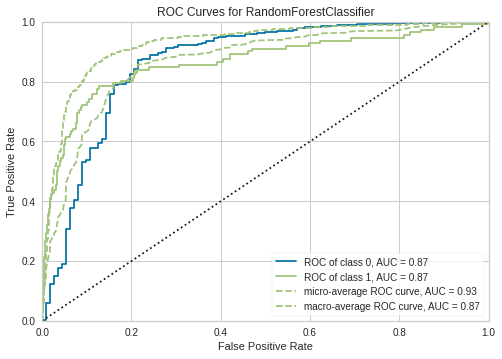

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [ ]:
plot_model(tuned_rf_pycaret, plot = 'auc')

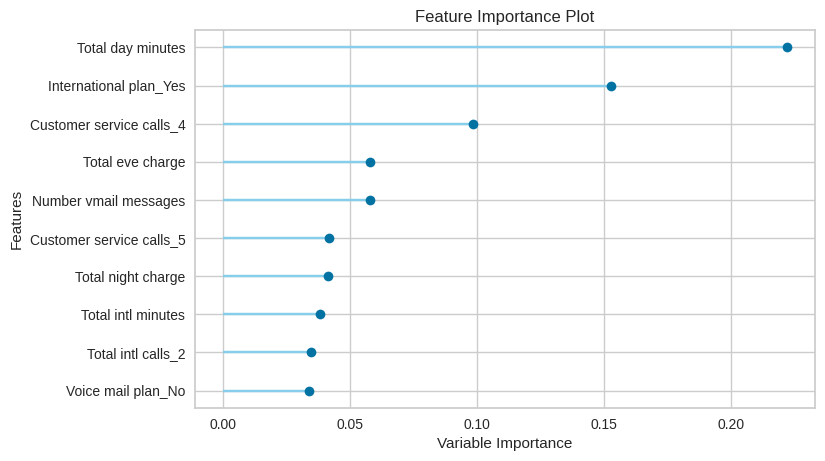

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [ ]:
plot_model(tuned_rf_pycaret, plot='feature')

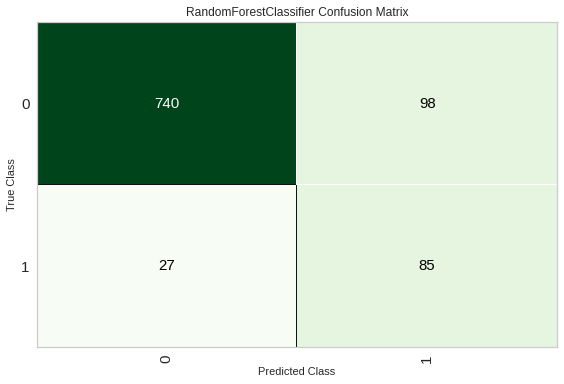

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [ ]:
plot_model(tuned_rf_pycaret, plot = 'confusion_matrix')

In [ ]:
evaluate_model(tuned_xgb_pycaret) #функция содержит в себе разные графики для данной модели

Initializing evaluate_model()
evaluate_model(estimator=XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.0005, max_delta_step=0, max_depth=7,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=60, n_jobs=-1, num_parallel_tree=1,
              objective='binary:logistic', random_state=348, reg_alpha=0.01,
              reg_lambda=0.4, scale_pos_weight=8.8, subsample=0.5,
              tree_method='auto', use_label_encoder=True, validate_parameters=1,
              verbosity=0), fold=None, fit_kwargs=None, feature_name=None, groups=None, use_train_data=False)


interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [ ]:
pred_rf_pycaret=predict_model(rf_pycaret); #предсказание на тестовой выборке для модели rf_pycaret

Initializing predict_model()
predict_model(estimator=RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=-1, oob_score=False, random_state=348, verbose=0,
                       warm_start=False), probability_threshold=None, encoded_labels=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None)
Checking exceptions
Preloading libraries
Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Random Forest Classifier,0.9347,0.8701,0.4911,0.9167,0.6395,0.6072,0.6431


In [ ]:
pred_tuned_rf_pycaret=predict_model(tuned_rf_pycaret); #предсказание на тестовой выборке для модели tuned_rf_pycaret

Initializing predict_model()
predict_model(estimator=RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=4, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0005, min_impurity_split=None,
                       min_samples_leaf=3, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=200,
                       n_jobs=-1, oob_score=False, random_state=348, verbose=0,
                       warm_start=False), probability_threshold=None, encoded_labels=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None)
Checking exceptions
Preloading libraries
Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Random Forest Classifier,0.8684,0.8666,0.7589,0.4645,0.5763,0.5037,0.525


In [ ]:
final_rf_pycaret = finalize_model(tuned_rf_pycaret) #обучаем модель по всему датасету (часть для обучения + часть для тестирования)

Initializing finalize_model()
finalize_model(estimator=RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=4, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0005, min_impurity_split=None,
                       min_samples_leaf=3, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=200,
                       n_jobs=-1, oob_score=False, random_state=348, verbose=0,
                       warm_start=False), fit_kwargs=None, groups=None, model_only=True, display=None)
Finalizing RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=4, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0005, min_impurity_split=None,
                       min_s

In [ ]:
pred_final_rf_pycaret=predict_model(final_rf_pycaret); #предсказываем с помощью финализированной модели

Initializing predict_model()
predict_model(estimator=RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=4, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0005, min_impurity_split=None,
                       min_samples_leaf=3, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=200,
                       n_jobs=-1, oob_score=False, random_state=348, verbose=0,
                       warm_start=False), probability_threshold=None, encoded_labels=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None)
Checking exceptions
Preloading libraries
Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Random Forest Classifier,0.8737,0.9012,0.7946,0.4785,0.5973,0.5278,0.5517


In [ ]:
pred_dt_pycaret=predict_model(dt_pycaret);
pred_tuned_dt_pycaret=predict_model(tuned_dt_pycaret);
final_dt_pycaret = finalize_model(tuned_dt_pycaret)
pred_final_dt_pycaret=predict_model(final_dt_pycaret);

Initializing predict_model()
predict_model(estimator=DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=348, splitter='best'), probability_threshold=None, encoded_labels=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None)
Checking exceptions
Preloading libraries
Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Decision Tree Classifier,0.9179,0.8258,0.7054,0.6371,0.6695,0.6228,0.6238


Initializing predict_model()
predict_model(estimator=DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=12, max_features=1.0, max_leaf_nodes=None,
                       min_impurity_decrease=0, min_impurity_split=None,
                       min_samples_leaf=3, min_samples_split=5,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=348, splitter='best'), probability_threshold=None, encoded_labels=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None)
Checking exceptions
Preloading libraries
Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Decision Tree Classifier,0.9389,0.832,0.6964,0.7647,0.729,0.6947,0.6956


Initializing finalize_model()
finalize_model(estimator=DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=12, max_features=1.0, max_leaf_nodes=None,
                       min_impurity_decrease=0, min_impurity_split=None,
                       min_samples_leaf=3, min_samples_split=5,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=348, splitter='best'), fit_kwargs=None, groups=None, model_only=True, display=None)
Finalizing DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=12, max_features=1.0, max_leaf_nodes=None,
                       min_impurity_decrease=0, min_impurity_split=None,
                       min_samples_leaf=3, min_samples_split=5,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=348, splitter='best')
Initializing create_mode

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Decision Tree Classifier,0.9695,0.9827,0.7946,0.9368,0.8599,0.8429,0.8465


In [ ]:
pred_knn_pycaret=predict_model(knn_pycaret);
pred_tuned_knn_pycaret=predict_model(tuned_knn_pycaret);
final_knn_pycaret = finalize_model(tuned_knn_pycaret)
pred_final_knn_pycaret=predict_model(final_knn_pycaret);

Initializing predict_model()
predict_model(estimator=KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=-1, n_neighbors=5, p=2,
                     weights='uniform'), probability_threshold=None, encoded_labels=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None)
Checking exceptions
Preloading libraries
Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,K Neighbors Classifier,0.8874,0.687,0.2321,0.5532,0.327,0.2766,0.308


Initializing predict_model()
predict_model(estimator=KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=-1, n_neighbors=35, p=2,
                     weights='uniform'), probability_threshold=None, encoded_labels=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None)
Checking exceptions
Preloading libraries
Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,K Neighbors Classifier,0.9021,0.7246,0.2143,0.8276,0.3404,0.3068,0.3905


Initializing finalize_model()
finalize_model(estimator=KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=-1, n_neighbors=35, p=2,
                     weights='uniform'), fit_kwargs=None, groups=None, model_only=True, display=None)
Finalizing KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=-1, n_neighbors=35, p=2,
                     weights='uniform')
Initializing create_model()
create_model(estimator=KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=-1, n_neighbors=35, p=2,
                     weights='uniform'), fold=None, round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, display=None, kwargs={})
Checking exceptions
Importing libraries
Copying training dataset
Defining folds
Declaring metric 

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,K Neighbors Classifier,0.9032,0.8024,0.2232,0.8333,0.3521,0.3181,0.4006


In [ ]:
pred_xgb_pycaret=predict_model(xgb_pycaret);
pred_tuned_xgb_pycaret=predict_model(tuned_xgb_pycaret);
final_xgb_pycaret = finalize_model(tuned_xgb_pycaret)
pred_final_xgb_pycaret=predict_model(final_xgb_pycaret);

Initializing predict_model()
predict_model(estimator=XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=-1, num_parallel_tree=1,
              objective='binary:logistic', random_state=348, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method='auto',
              use_label_encoder=True, validate_parameters=1, verbosity=0), probability_threshold=None, encoded_labels=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None)
Checking exceptions
Preloading libraries
Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Extreme Gradient Boosting,0.9526,0.887,0.6964,0.8764,0.7761,0.75,0.7562


Initializing predict_model()
predict_model(estimator=XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.0005, max_delta_step=0, max_depth=7,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=60, n_jobs=-1, num_parallel_tree=1,
              objective='binary:logistic', random_state=348, reg_alpha=0.01,
              reg_lambda=0.4, scale_pos_weight=8.8, subsample=0.5,
              tree_method='auto', use_label_encoder=True, validate_parameters=1,
              verbosity=0), probability_threshold=None, encoded_labels=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None)
Checking exceptions
Preloading libraries
Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Extreme Gradient Boosting,0.9189,0.897,0.7857,0.6241,0.6957,0.6496,0.6553


Initializing finalize_model()
finalize_model(estimator=XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.0005, max_delta_step=0, max_depth=7,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=60, n_jobs=-1, num_parallel_tree=1,
              objective='binary:logistic', random_state=348, reg_alpha=0.01,
              reg_lambda=0.4, scale_pos_weight=8.8, subsample=0.5,
              tree_method='auto', use_label_encoder=True, validate_parameters=1,
              verbosity=0), fit_kwargs=None, groups=None, model_only=True, display=None)
Finalizing XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints=''

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Extreme Gradient Boosting,0.9505,0.9533,0.8482,0.76,0.8017,0.7735,0.775


In [ ]:
pred_lgbm_pycaret=predict_model(lgbm_pycaret);
pred_tuned_lgbm_pycaret=predict_model(tuned_lgbm_pycaret);
final_lgbm_pycaret = finalize_model(tuned_lgbm_pycaret)
pred_final_lgbm_pycaret=predict_model(final_lgbm_pycaret);

Initializing predict_model()
predict_model(estimator=LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=348, reg_alpha=0.0, reg_lambda=0.0, silent=True,
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0), probability_threshold=None, encoded_labels=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None)
Checking exceptions
Preloading libraries
Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.9568,0.9095,0.6875,0.9277,0.7897,0.7663,0.777


Initializing predict_model()
predict_model(estimator=LGBMClassifier(bagging_fraction=0.6, bagging_freq=1, boosting_type='gbdt',
               class_weight=None, colsample_bytree=1.0, feature_fraction=1.0,
               importance_type='split', learning_rate=0.3, max_depth=-1,
               min_child_samples=66, min_child_weight=0.001, min_split_gain=0.5,
               n_estimators=180, n_jobs=-1, num_leaves=30, objective=None,
               random_state=348, reg_alpha=0.3, reg_lambda=10, silent=True,
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0), probability_threshold=None, encoded_labels=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None)
Checking exceptions
Preloading libraries
Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.9147,0.8698,0.5446,0.6703,0.601,0.5538,0.5576


Initializing finalize_model()
finalize_model(estimator=LGBMClassifier(bagging_fraction=0.6, bagging_freq=1, boosting_type='gbdt',
               class_weight=None, colsample_bytree=1.0, feature_fraction=1.0,
               importance_type='split', learning_rate=0.3, max_depth=-1,
               min_child_samples=66, min_child_weight=0.001, min_split_gain=0.5,
               n_estimators=180, n_jobs=-1, num_leaves=30, objective=None,
               random_state=348, reg_alpha=0.3, reg_lambda=10, silent=True,
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0), fit_kwargs=None, groups=None, model_only=True, display=None)
Finalizing LGBMClassifier(bagging_fraction=0.6, bagging_freq=1, boosting_type='gbdt',
               class_weight=None, colsample_bytree=1.0, feature_fraction=1.0,
               importance_type='split', learning_rate=0.3, max_depth=-1,
               min_child_samples=66, min_child_weight=0.001, min_split_gain=0.5,
               n_estimators=180, 

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.98,0.9899,0.8482,0.9794,0.9091,0.8979,0.9009


In [ ]:
pred_cb_pycaret=predict_model(cb_pycaret);
pred_tuned_cb_pycaret=predict_model(tuned_cb_pycaret);
final_cb_pycaret = finalize_model(tuned_cb_pycaret)
pred_final_cb_pycaret=predict_model(final_cb_pycaret);

Initializing predict_model()
predict_model(estimator=<catboost.core.CatBoostClassifier object at 0x7f335fb66ed0>, probability_threshold=None, encoded_labels=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None)
Checking exceptions
Preloading libraries
Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,CatBoost Classifier,0.9568,0.9083,0.7143,0.8989,0.796,0.7722,0.7786


Initializing predict_model()
predict_model(estimator=<catboost.core.CatBoostClassifier object at 0x7f3360cf9810>, probability_threshold=None, encoded_labels=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None)
Checking exceptions
Preloading libraries
Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,CatBoost Classifier,0.9505,0.9095,0.7143,0.8421,0.7729,0.7454,0.7486


Initializing finalize_model()
finalize_model(estimator=<catboost.core.CatBoostClassifier object at 0x7f3360cf9810>, fit_kwargs=None, groups=None, model_only=True, display=None)
Finalizing <catboost.core.CatBoostClassifier object at 0x7f3360cf9810>
Initializing create_model()
create_model(estimator=<catboost.core.CatBoostClassifier object at 0x7f3360cf9810>, fold=None, round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, display=None, kwargs={})
Checking exceptions
Importing libraries
Copying training dataset
Defining folds
Declaring metric variables
Importing untrained model
Declaring custom model
CatBoost Classifier Imported succesfully
Starting cross validation
Cross validating with StratifiedKFold(n_splits=10, random_state=None, shuffle=False), n_jobs=-1
Calculating mean and std
Creating metrics dataframe
Finalizing model
Uploading results into container
Uploading model into container now
create_model_contai

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,CatBoost Classifier,0.98,0.9875,0.8304,1.0,0.9073,0.8962,0.9011


In [ ]:
unseen_pred_pc_rf = predict_model(final_rf_pycaret, data=data_unseen)
#unseen_pred_pc_rf.head(20)
unseen_pred_pc_rf['Label'].astype(str)

res_pred_pc_rf=unseen_pred_pc_rf.where((unseen_pred_pc_rf['Label']=='True')&(unseen_pred_pc_rf['Churn']==True)) #датасет с данными где предсказали прекращение контракта и это на самом деле случилось
res_pred_pc_rf=res_pred_pc_rf.dropna() 
res_pred_pc_rf.head(22) 

Initializing predict_model()
predict_model(estimator=RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=4, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0005, min_impurity_split=None,
                       min_samples_leaf=3, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=200,
                       n_jobs=-1, oob_score=False, random_state=348, verbose=0,
                       warm_start=False), probability_threshold=None, encoded_labels=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None)
Checking exceptions
Preloading libraries
Preparing display monitor


,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn,Label,Score
5,IN,94.0,408.0,No,No,0.0,157.9,105.0,26.84,155.0,101.0,13.18,189.6,84.0,8.53,8.0,5.0,2.16,4.0,1.0,True,0.5196
30,MA,88.0,415.0,No,No,0.0,264.8,124.0,45.02,245.4,112.0,20.86,160.5,115.0,7.22,14.8,2.0,4.00,1.0,1.0,True,0.6075
34,MN,152.0,415.0,Yes,Yes,20.0,237.5,120.0,40.38,253.4,94.0,21.54,265.2,80.0,11.93,14.2,3.0,3.83,9.0,1.0,True,0.5964
49,MA,127.0,408.0,Yes,No,0.0,176.9,110.0,30.07,167.9,100.0,14.27,182.2,138.0,8.20,7.7,2.0,2.08,1.0,1.0,True,0.5674
55,MA,136.0,408.0,Yes,No,0.0,199.6,89.0,33.93,211.4,96.0,17.97,72.4,84.0,3.26,11.0,4.0,2.97,3.0,1.0,True,0.5184
58,CA,112.0,415.0,No,No,0.0,111.9,92.0,19.02,114.0,143.0,9.69,146.8,79.0,6.61,14.1,3.0,3.81,5.0,1.0,True,0.5416
61,NY,108.0,415.0,No,No,0.0,154.2,123.0,26.21,112.3,86.0,9.55,246.4,75.0,11.09,15.4,4.0,4.16,4.0,1.0,True,0.5592
118,AR,98.0,415.0,No,No,0.0,227.1,116.0,38.61,120.5,103.0,10.24,117.0,102.0,5.27,4.7,4.0,1.27,5.0,1.0,True,0.5117
123,WI,89.0,415.0,No,No,0.0,326.3,112.0,55.47,165.1,110.0,14.03,162.9,97.0,7.33,7.5,1.0,2.03,1.0,1.0,True,0.5372
124,DC,114.0,415.0,No,No,0.0,147.1,119.0,25.01,161.0,111.0,13.69,275.9,106.0,12.42,9.0,3.0,2.43,5.0,1.0,True,0.5419


In [ ]:
unseen_pred_pc_xgb = predict_model(final_xgb_pycaret, data=data_unseen)

res_pred_pc_xgb=unseen_pred_pc_xgb.where((unseen_pred_pc_xgb['Label']=='True')&(unseen_pred_pc_xgb['Churn']==True)) #датасет с данными где предсказали прекращение контракта и это на самом деле случилось
res_pred_pc_xgb=res_pred_pc_xgb.dropna() 
res_pred_pc_xgb.head(22)

Initializing predict_model()
predict_model(estimator=XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.0005, max_delta_step=0, max_depth=7,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=60, n_jobs=-1, num_parallel_tree=1,
              objective='binary:logistic', random_state=348, reg_alpha=0.01,
              reg_lambda=0.4, scale_pos_weight=8.8, subsample=0.5,
              tree_method='auto', use_label_encoder=True, validate_parameters=1,
              verbosity=0), probability_threshold=None, encoded_labels=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None)
Checking exceptions
Preloading libraries
Preparing display monitor


,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn,Label,Score
5,IN,94.0,408.0,No,No,0.0,157.9,105.0,26.84,155.0,101.0,13.18,189.6,84.0,8.53,8.0,5.0,2.16,4.0,1.0,True,0.5089
30,MA,88.0,415.0,No,No,0.0,264.8,124.0,45.02,245.4,112.0,20.86,160.5,115.0,7.22,14.8,2.0,4.00,1.0,1.0,True,0.5128
34,MN,152.0,415.0,Yes,Yes,20.0,237.5,120.0,40.38,253.4,94.0,21.54,265.2,80.0,11.93,14.2,3.0,3.83,9.0,1.0,True,0.5081
49,MA,127.0,408.0,Yes,No,0.0,176.9,110.0,30.07,167.9,100.0,14.27,182.2,138.0,8.20,7.7,2.0,2.08,1.0,1.0,True,0.5143
58,CA,112.0,415.0,No,No,0.0,111.9,92.0,19.02,114.0,143.0,9.69,146.8,79.0,6.61,14.1,3.0,3.81,5.0,1.0,True,0.5144
61,NY,108.0,415.0,No,No,0.0,154.2,123.0,26.21,112.3,86.0,9.55,246.4,75.0,11.09,15.4,4.0,4.16,4.0,1.0,True,0.5143
120,NY,82.0,415.0,No,No,0.0,167.1,77.0,28.41,131.8,79.0,11.20,187.4,98.0,8.43,9.4,1.0,2.54,6.0,1.0,True,0.5107
123,WI,89.0,415.0,No,No,0.0,326.3,112.0,55.47,165.1,110.0,14.03,162.9,97.0,7.33,7.5,1.0,2.03,1.0,1.0,True,0.5063
124,DC,114.0,415.0,No,No,0.0,147.1,119.0,25.01,161.0,111.0,13.69,275.9,106.0,12.42,9.0,3.0,2.43,5.0,1.0,True,0.5142
131,SC,116.0,408.0,No,No,0.0,288.0,120.0,48.96,255.8,90.0,21.74,233.4,99.0,10.50,13.4,4.0,3.62,0.0,1.0,True,0.5145


In [ ]:
unseen_pred_pc_lgbm = predict_model(final_lgbm_pycaret, data=data_unseen)

res_pred_pc_lgbm=unseen_pred_pc_lgbm.where((unseen_pred_pc_lgbm['Label']=='True')&(unseen_pred_pc_lgbm['Churn']==True)) #датасет с данными где предсказали прекращение контракта и это на самом деле случилось
res_pred_pc_lgbm=res_pred_pc_lgbm.dropna() 
res_pred_pc_lgbm.head(22)

Initializing predict_model()
predict_model(estimator=LGBMClassifier(bagging_fraction=0.6, bagging_freq=1, boosting_type='gbdt',
               class_weight=None, colsample_bytree=1.0, feature_fraction=1.0,
               importance_type='split', learning_rate=0.3, max_depth=-1,
               min_child_samples=66, min_child_weight=0.001, min_split_gain=0.5,
               n_estimators=180, n_jobs=-1, num_leaves=30, objective=None,
               random_state=348, reg_alpha=0.3, reg_lambda=10, silent=True,
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0), probability_threshold=None, encoded_labels=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None)
Checking exceptions
Preloading libraries
Preparing display monitor


,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn,Label,Score
5,IN,94.0,408.0,No,No,0.0,157.9,105.0,26.84,155.0,101.0,13.18,189.6,84.0,8.53,8.0,5.0,2.16,4.0,1.0,True,0.8888
30,MA,88.0,415.0,No,No,0.0,264.8,124.0,45.02,245.4,112.0,20.86,160.5,115.0,7.22,14.8,2.0,4.00,1.0,1.0,True,0.8607
34,MN,152.0,415.0,Yes,Yes,20.0,237.5,120.0,40.38,253.4,94.0,21.54,265.2,80.0,11.93,14.2,3.0,3.83,9.0,1.0,True,0.6893
58,CA,112.0,415.0,No,No,0.0,111.9,92.0,19.02,114.0,143.0,9.69,146.8,79.0,6.61,14.1,3.0,3.81,5.0,1.0,True,0.6390
61,NY,108.0,415.0,No,No,0.0,154.2,123.0,26.21,112.3,86.0,9.55,246.4,75.0,11.09,15.4,4.0,4.16,4.0,1.0,True,0.8528
120,NY,82.0,415.0,No,No,0.0,167.1,77.0,28.41,131.8,79.0,11.20,187.4,98.0,8.43,9.4,1.0,2.54,6.0,1.0,True,0.6291
131,SC,116.0,408.0,No,No,0.0,288.0,120.0,48.96,255.8,90.0,21.74,233.4,99.0,10.50,13.4,4.0,3.62,0.0,1.0,True,0.9913
151,NY,131.0,408.0,Yes,No,0.0,122.3,83.0,20.79,118.8,94.0,10.10,147.9,95.0,6.66,13.7,3.0,3.70,3.0,1.0,True,0.7909
152,MI,108.0,408.0,Yes,No,0.0,115.1,114.0,19.57,211.3,70.0,17.96,136.1,85.0,6.12,13.8,3.0,3.73,2.0,1.0,True,0.5065
164,AR,76.0,408.0,No,No,0.0,107.3,140.0,18.24,238.2,133.0,20.25,271.8,116.0,12.23,10.0,3.0,2.70,4.0,1.0,True,0.8857


In [ ]:
unseen_pred_pc_cb = predict_model(final_cb_pycaret, data=data_unseen)

res_pred_pc_cb=unseen_pred_pc_cb.where((unseen_pred_pc_cb['Label']=='True')&(unseen_pred_pc_cb['Churn']==True)) #датасет с данными где предсказали прекращение контракта и это на самом деле случилось
res_pred_pc_cb=res_pred_pc_cb.dropna() 
res_pred_pc_cb.head(22)

Initializing predict_model()
predict_model(estimator=<catboost.core.CatBoostClassifier object at 0x7f33635fdb10>, probability_threshold=None, encoded_labels=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None)
Checking exceptions
Preloading libraries
Preparing display monitor


,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn,Label,Score
5,IN,94.0,408.0,No,No,0.0,157.9,105.0,26.84,155.0,101.0,13.18,189.6,84.0,8.53,8.0,5.0,2.16,4.0,1.0,True,0.6002
30,MA,88.0,415.0,No,No,0.0,264.8,124.0,45.02,245.4,112.0,20.86,160.5,115.0,7.22,14.8,2.0,4.00,1.0,1.0,True,0.7428
34,MN,152.0,415.0,Yes,Yes,20.0,237.5,120.0,40.38,253.4,94.0,21.54,265.2,80.0,11.93,14.2,3.0,3.83,9.0,1.0,True,0.9980
49,MA,127.0,408.0,Yes,No,0.0,176.9,110.0,30.07,167.9,100.0,14.27,182.2,138.0,8.20,7.7,2.0,2.08,1.0,1.0,True,0.8738
58,CA,112.0,415.0,No,No,0.0,111.9,92.0,19.02,114.0,143.0,9.69,146.8,79.0,6.61,14.1,3.0,3.81,5.0,1.0,True,0.9884
61,NY,108.0,415.0,No,No,0.0,154.2,123.0,26.21,112.3,86.0,9.55,246.4,75.0,11.09,15.4,4.0,4.16,4.0,1.0,True,0.8008
123,WI,89.0,415.0,No,No,0.0,326.3,112.0,55.47,165.1,110.0,14.03,162.9,97.0,7.33,7.5,1.0,2.03,1.0,1.0,True,0.5118
124,DC,114.0,415.0,No,No,0.0,147.1,119.0,25.01,161.0,111.0,13.69,275.9,106.0,12.42,9.0,3.0,2.43,5.0,1.0,True,0.9209
131,SC,116.0,408.0,No,No,0.0,288.0,120.0,48.96,255.8,90.0,21.74,233.4,99.0,10.50,13.4,4.0,3.62,0.0,1.0,True,0.9990
151,NY,131.0,408.0,Yes,No,0.0,122.3,83.0,20.79,118.8,94.0,10.10,147.9,95.0,6.66,13.7,3.0,3.70,3.0,1.0,True,0.9376


При обучении моделей с помощью бибилиотеки PyCaret из 22 отказов правильно были предсказаны:<br>
15 в модели Random Forest<br>
14 в модели XGBoost<br>
13 в модели CatBoost<br>
10 в модели LightGBM

In [ ]:
#меняем тип у не числовых переменноых
#unseen_pred_pc_rf['Churn']=unseen_pred_pc_rf['Churn'].astype('int64')
#d={False:0, True:1}
#unseen_pred_pc_rf['Churn']=unseen_pred_pc_rf['Churn'].map(d) 
d1={'False':0, 'True':1}
unseen_pred_pc_rf['Label']=unseen_pred_pc_rf['Label'].map(d1) 
from pycaret.utils import check_metric
check_metric(actual=unseen_pred_pc_rf['Churn'], prediction=unseen_pred_pc_rf['Label'], metric='Accuracy') #считаем Accuracy пердсказания на новых данных с помощью random forest

0.8263

#Сравнение моделей, построенных с помощью бибилиотеки PyCaret

In [ ]:
accuracy_pred_dt_pycaret=check_metric(actual=pred_dt_pycaret['Churn'], prediction=pred_dt_pycaret['Label'], metric='Accuracy')
prec_pred_dt_pycaret=check_metric(actual=pred_dt_pycaret['Churn'], prediction=pred_dt_pycaret['Label'], metric='Precision')
recall_pred_dt_pycaret=check_metric(actual=pred_dt_pycaret['Churn'], prediction=pred_dt_pycaret['Label'], metric='Recall')
auc_pred_dt_pycaret=check_metric(actual=pred_dt_pycaret['Churn'], prediction=pred_dt_pycaret['Label'], metric='AUC')

accuracy_pred_tuned_dt_pycaret=check_metric(actual=pred_tuned_dt_pycaret['Churn'], prediction=pred_tuned_dt_pycaret['Label'], metric='Accuracy')
prec_pred_tuned_dt_pycaret=check_metric(actual=pred_tuned_dt_pycaret['Churn'], prediction=pred_tuned_dt_pycaret['Label'], metric='Precision')
recall_pred_tuned_dt_pycaret=check_metric(actual=pred_tuned_dt_pycaret['Churn'], prediction=pred_tuned_dt_pycaret['Label'], metric='Recall')
auc_pred_tuned_dt_pycaret=check_metric(actual=pred_tuned_dt_pycaret['Churn'], prediction=pred_tuned_dt_pycaret['Label'], metric='AUC')

accuracy_pred_final_dt_pycaret=check_metric(actual=pred_final_dt_pycaret['Churn'], prediction=pred_final_dt_pycaret['Label'], metric='Accuracy')
prec_pred_final_dt_pycaret=check_metric(actual=pred_final_dt_pycaret['Churn'], prediction=pred_final_dt_pycaret['Label'], metric='Precision')
recall_pred_final_dt_pycaret=check_metric(actual=pred_final_dt_pycaret['Churn'], prediction=pred_final_dt_pycaret['Label'], metric='Recall')
auc_pred_final_dt_pycaret=check_metric(actual=pred_final_dt_pycaret['Churn'], prediction=pred_final_dt_pycaret['Label'], metric='AUC')

accuracy_pred_knn_pycaret=check_metric(actual=pred_knn_pycaret['Churn'], prediction=pred_knn_pycaret['Label'], metric='Accuracy')
prec_pred_knn_pycaret=check_metric(actual=pred_dt_pycaret['Churn'], prediction=pred_knn_pycaret['Label'], metric='Precision')
recall_pred_knn_pycaret=check_metric(actual=pred_dt_pycaret['Churn'], prediction=pred_knn_pycaret['Label'], metric='Recall')
auc_pred_knn_pycaret=check_metric(actual=pred_dt_pycaret['Churn'], prediction=pred_knn_pycaret['Label'], metric='AUC')

accuracy_pred_tuned_knn_pycaret=check_metric(actual=pred_tuned_knn_pycaret['Churn'], prediction=pred_tuned_knn_pycaret['Label'], metric='Accuracy')
prec_pred_tuned_knn_pycaret=check_metric(actual=pred_tuned_knn_pycaret['Churn'], prediction=pred_tuned_knn_pycaret['Label'], metric='Precision')
recall_pred_tuned_knn_pycaret=check_metric(actual=pred_tuned_knn_pycaret['Churn'], prediction=pred_tuned_knn_pycaret['Label'], metric='Recall')
auc_pred_tuned_knn_pycaret=check_metric(actual=pred_tuned_knn_pycaret['Churn'], prediction=pred_tuned_knn_pycaret['Label'], metric='AUC')

accuracy_pred_final_knn_pycaret=check_metric(actual=pred_final_knn_pycaret['Churn'], prediction=pred_final_knn_pycaret['Label'], metric='Accuracy')
prec_pred_final_knn_pycaret=check_metric(actual=pred_final_knn_pycaret['Churn'], prediction=pred_final_knn_pycaret['Label'], metric='Precision')
recall_pred_final_knn_pycaret=check_metric(actual=pred_final_knn_pycaret['Churn'], prediction=pred_final_knn_pycaret['Label'], metric='Recall')
auc_pred_final_knn_pycaret=check_metric(actual=pred_final_knn_pycaret['Churn'], prediction=pred_final_knn_pycaret['Label'], metric='AUC')

accuracy_pred_rf_pycaret=check_metric(actual=pred_rf_pycaret['Churn'], prediction=pred_rf_pycaret['Label'], metric='Accuracy')
prec_pred_rf_pycaret=check_metric(actual=pred_rf_pycaret['Churn'], prediction=pred_rf_pycaret['Label'], metric='Precision')
recall_pred_rf_pycaret=check_metric(actual=pred_rf_pycaret['Churn'], prediction=pred_rf_pycaret['Label'], metric='Recall')
auc_pred_rf_pycaret=check_metric(actual=pred_rf_pycaret['Churn'], prediction=pred_rf_pycaret['Label'], metric='AUC')

accuracy_pred_tuned_rf_pycaret=check_metric(actual=pred_tuned_rf_pycaret['Churn'], prediction=pred_tuned_rf_pycaret['Label'], metric='Accuracy')
prec_pred_tuned_rf_pycaret=check_metric(actual=pred_tuned_rf_pycaret['Churn'], prediction=pred_tuned_rf_pycaret['Label'], metric='Precision')
recall_pred_tuned_rf_pycaret=check_metric(actual=pred_tuned_rf_pycaret['Churn'], prediction=pred_tuned_rf_pycaret['Label'], metric='Recall')
auc_pred_tuned_rf_pycaret=check_metric(actual=pred_tuned_rf_pycaret['Churn'], prediction=pred_tuned_rf_pycaret['Label'], metric='AUC')

accuracy_pred_final_rf_pycaret=check_metric(actual=pred_final_rf_pycaret['Churn'], prediction=pred_final_rf_pycaret['Label'], metric='Accuracy')
prec_pred_final_rf_pycaret=check_metric(actual=pred_final_rf_pycaret['Churn'], prediction=pred_final_rf_pycaret['Label'], metric='Precision')
recall_pred_final_rf_pycaret=check_metric(actual=pred_final_rf_pycaret['Churn'], prediction=pred_final_rf_pycaret['Label'], metric='Recall')
auc_pred_final_rf_pycaret=check_metric(actual=pred_final_rf_pycaret['Churn'], prediction=pred_final_rf_pycaret['Label'], metric='AUC')

accuracy_pred_xgb_pycaret=check_metric(actual=pred_xgb_pycaret['Churn'], prediction=pred_xgb_pycaret['Label'], metric='Accuracy')
prec_pred_xgb_pycaret=check_metric(actual=pred_xgb_pycaret['Churn'], prediction=pred_xgb_pycaret['Label'], metric='Precision')
recall_pred_xgb_pycaret=check_metric(actual=pred_xgb_pycaret['Churn'], prediction=pred_xgb_pycaret['Label'], metric='Recall')
auc_pred_xgb_pycaret=check_metric(actual=pred_xgb_pycaret['Churn'], prediction=pred_xgb_pycaret['Label'], metric='AUC')

accuracy_pred_tuned_xgb_pycaret=check_metric(actual=pred_tuned_xgb_pycaret['Churn'], prediction=pred_tuned_xgb_pycaret['Label'], metric='Accuracy')
prec_pred_tuned_xgb_pycaret=check_metric(actual=pred_tuned_xgb_pycaret['Churn'], prediction=pred_tuned_xgb_pycaret['Label'], metric='Precision')
recall_pred_tuned_xgb_pycaret=check_metric(actual=pred_tuned_xgb_pycaret['Churn'], prediction=pred_tuned_xgb_pycaret['Label'], metric='Recall')
auc_pred_tuned_xgb_pycaret=check_metric(actual=pred_tuned_xgb_pycaret['Churn'], prediction=pred_tuned_xgb_pycaret['Label'], metric='AUC')

accuracy_pred_final_xgb_pycaret=check_metric(actual=pred_final_xgb_pycaret['Churn'], prediction=pred_final_xgb_pycaret['Label'], metric='Accuracy')
prec_pred_final_xgb_pycaret=check_metric(actual=pred_final_xgb_pycaret['Churn'], prediction=pred_final_xgb_pycaret['Label'], metric='Precision')
recall_pred_final_xgb_pycaret=check_metric(actual=pred_final_xgb_pycaret['Churn'], prediction=pred_final_xgb_pycaret['Label'], metric='Recall')
auc_pred_final_xgb_pycaret=check_metric(actual=pred_final_xgb_pycaret['Churn'], prediction=pred_final_xgb_pycaret['Label'], metric='AUC')

accuracy_pred_lgbm_pycaret=check_metric(actual=pred_lgbm_pycaret['Churn'], prediction=pred_lgbm_pycaret['Label'], metric='Accuracy')
prec_pred_lgbm_pycaret=check_metric(actual=pred_lgbm_pycaret['Churn'], prediction=pred_lgbm_pycaret['Label'], metric='Precision')
recall_pred_lgbm_pycaret=check_metric(actual=pred_lgbm_pycaret['Churn'], prediction=pred_lgbm_pycaret['Label'], metric='Recall')
auc_pred_lgbm_pycaret=check_metric(actual=pred_lgbm_pycaret['Churn'], prediction=pred_lgbm_pycaret['Label'], metric='AUC')

accuracy_pred_tuned_lgbm_pycaret=check_metric(actual=pred_tuned_lgbm_pycaret['Churn'], prediction=pred_tuned_lgbm_pycaret['Label'], metric='Accuracy')
prec_pred_tuned_lgbm_pycaret=check_metric(actual=pred_tuned_lgbm_pycaret['Churn'], prediction=pred_tuned_lgbm_pycaret['Label'], metric='Precision')
recall_pred_tuned_lgbm_pycaret=check_metric(actual=pred_tuned_lgbm_pycaret['Churn'], prediction=pred_tuned_lgbm_pycaret['Label'], metric='Recall')
auc_pred_tuned_lgbm_pycaret=check_metric(actual=pred_tuned_lgbm_pycaret['Churn'], prediction=pred_tuned_lgbm_pycaret['Label'], metric='AUC')

accuracy_pred_final_lgbm_pycaret=check_metric(actual=pred_final_lgbm_pycaret['Churn'], prediction=pred_final_lgbm_pycaret['Label'], metric='Accuracy')
prec_pred_final_lgbm_pycaret=check_metric(actual=pred_final_lgbm_pycaret['Churn'], prediction=pred_final_lgbm_pycaret['Label'], metric='Precision')
recall_pred_final_lgbm_pycaret=check_metric(actual=pred_final_lgbm_pycaret['Churn'], prediction=pred_final_lgbm_pycaret['Label'], metric='Recall')
auc_pred_final_lgbm_pycaret=check_metric(actual=pred_final_lgbm_pycaret['Churn'], prediction=pred_final_lgbm_pycaret['Label'], metric='AUC')

accuracy_pred_cb_pycaret=check_metric(actual=pred_cb_pycaret['Churn'], prediction=pred_cb_pycaret['Label'], metric='Accuracy')
prec_pred_cb_pycaret=check_metric(actual=pred_cb_pycaret['Churn'], prediction=pred_cb_pycaret['Label'], metric='Precision')
recall_pred_cb_pycaret=check_metric(actual=pred_cb_pycaret['Churn'], prediction=pred_cb_pycaret['Label'], metric='Recall')
auc_pred_cb_pycaret=check_metric(actual=pred_cb_pycaret['Churn'], prediction=pred_cb_pycaret['Label'], metric='AUC')

accuracy_pred_tuned_cb_pycaret=check_metric(actual=pred_tuned_cb_pycaret['Churn'], prediction=pred_tuned_cb_pycaret['Label'], metric='Accuracy')
prec_pred_tuned_cb_pycaret=check_metric(actual=pred_tuned_cb_pycaret['Churn'], prediction=pred_tuned_cb_pycaret['Label'], metric='Precision')
recall_pred_tuned_cb_pycaret=check_metric(actual=pred_tuned_cb_pycaret['Churn'], prediction=pred_tuned_cb_pycaret['Label'], metric='Recall')
auc_pred_tuned_cb_pycaret=check_metric(actual=pred_tuned_cb_pycaret['Churn'], prediction=pred_tuned_cb_pycaret['Label'], metric='AUC')

accuracy_pred_final_cb_pycaret=check_metric(actual=pred_final_cb_pycaret['Churn'], prediction=pred_final_cb_pycaret['Label'], metric='Accuracy')
prec_pred_final_cb_pycaret=check_metric(actual=pred_final_cb_pycaret['Churn'], prediction=pred_final_cb_pycaret['Label'], metric='Precision')
recall_pred_final_cb_pycaret=check_metric(actual=pred_final_cb_pycaret['Churn'], prediction=pred_final_cb_pycaret['Label'], metric='Recall')
auc_pred_final_cb_pycaret=check_metric(actual=pred_final_cb_pycaret['Churn'], prediction=pred_final_cb_pycaret['Label'], metric='AUC')

metrics_name_pycaret=['Accuracy', 'Precision', 'Recall', 'Roc_auc']
DT_pycaret=[accuracy_pred_dt_pycaret,prec_pred_dt_pycaret, recall_pred_dt_pycaret,auc_pred_dt_pycaret]
DT_tuned_pycaret=[accuracy_pred_tuned_dt_pycaret,prec_pred_tuned_dt_pycaret, recall_pred_tuned_dt_pycaret,auc_pred_tuned_dt_pycaret]
DT_final_pycaret=[accuracy_pred_final_dt_pycaret,prec_pred_final_dt_pycaret, recall_pred_final_dt_pycaret,auc_pred_final_dt_pycaret]

KNN_pycaret=[accuracy_pred_knn_pycaret,prec_pred_knn_pycaret, recall_pred_knn_pycaret,auc_pred_knn_pycaret]
KNN_tuned_pycaret=[accuracy_pred_tuned_knn_pycaret,prec_pred_tuned_knn_pycaret, recall_pred_tuned_knn_pycaret,auc_pred_tuned_knn_pycaret]
KNN_final_pycaret=[accuracy_pred_final_knn_pycaret,prec_pred_final_knn_pycaret, recall_pred_final_knn_pycaret,auc_pred_final_knn_pycaret]

RF_pycaret=[accuracy_pred_rf_pycaret,prec_pred_rf_pycaret, recall_pred_rf_pycaret,auc_pred_rf_pycaret]
RF_tuned_pycaret=[accuracy_pred_tuned_rf_pycaret,prec_pred_tuned_rf_pycaret, recall_pred_tuned_rf_pycaret,auc_pred_tuned_rf_pycaret]
RF_final_pycaret=[accuracy_pred_final_rf_pycaret,prec_pred_final_rf_pycaret, recall_pred_final_rf_pycaret,auc_pred_final_rf_pycaret]

XGB_pycaret=[accuracy_pred_xgb_pycaret,prec_pred_xgb_pycaret, recall_pred_xgb_pycaret,auc_pred_xgb_pycaret]
XGB_tuned_pycaret=[accuracy_pred_tuned_xgb_pycaret,prec_pred_tuned_xgb_pycaret, recall_pred_tuned_xgb_pycaret,auc_pred_tuned_xgb_pycaret]
XGB_final_pycaret=[accuracy_pred_final_xgb_pycaret,prec_pred_final_xgb_pycaret, recall_pred_final_xgb_pycaret,auc_pred_final_xgb_pycaret]

LGBM_pycaret=[accuracy_pred_lgbm_pycaret,prec_pred_lgbm_pycaret, recall_pred_lgbm_pycaret,auc_pred_lgbm_pycaret]
LGBM_tuned_pycaret=[accuracy_pred_tuned_lgbm_pycaret,prec_pred_tuned_lgbm_pycaret, recall_pred_tuned_lgbm_pycaret,auc_pred_tuned_lgbm_pycaret]
LGBM_final_pycaret=[accuracy_pred_final_lgbm_pycaret,prec_pred_final_lgbm_pycaret, recall_pred_final_lgbm_pycaret,auc_pred_final_lgbm_pycaret]

CB_pycaret=[accuracy_pred_cb_pycaret,prec_pred_cb_pycaret, recall_pred_cb_pycaret,auc_pred_cb_pycaret]
CB_tuned_pycaret=[accuracy_pred_tuned_cb_pycaret,prec_pred_tuned_cb_pycaret, recall_pred_tuned_cb_pycaret,auc_pred_tuned_cb_pycaret]
CB_final_pycaret=[accuracy_pred_final_cb_pycaret,prec_pred_final_cb_pycaret, recall_pred_final_cb_pycaret,auc_pred_final_cb_pycaret]
res_table_pycaret=pd.DataFrame(list(zip(metrics_name_pycaret,DT_pycaret,DT_tuned_pycaret,DT_final_pycaret,KNN_pycaret,KNN_tuned_pycaret,KNN_final_pycaret,RF_pycaret,RF_tuned_pycaret,RF_final_pycaret,XGB_pycaret,XGB_tuned_pycaret,XGB_final_pycaret,LGBM_pycaret,LGBM_tuned_pycaret,LGBM_final_pycaret,CB_pycaret,CB_tuned_pycaret,CB_final_pycaret)),
                               columns= ['Metrics','Decision Tree','Decision Tree tuned','Decision Tree final','KNN','KNN tuned','KNN final','Random Forest','Random Forest tuned','Random Forest final','XGBoost','XGBoost tuned','XGBoost final','Lightgbm','Lightgbm tuned','Lightgbm final','CatBoost','CatBoost tuned','CatBoost final'])
res_table_pycaret.head()

,Metrics,Decision Tree,Decision Tree tuned,Decision Tree final,KNN,KNN tuned,KNN final,Random Forest,Random Forest tuned,Random Forest final,XGBoost,XGBoost tuned,XGBoost final,Lightgbm,Lightgbm tuned,Lightgbm final,CatBoost,CatBoost tuned,CatBoost final
0,Accuracy,0.9179,0.9389,0.9695,0.8874,0.9021,0.9032,0.9347,0.8684,0.8737,0.9526,0.9189,0.9505,0.9568,0.9147,0.9800,0.9568,0.9505,0.9800
1,Precision,0.6371,0.7647,0.9368,0.5532,0.8276,0.8333,0.9167,0.4645,0.4785,0.8764,0.6241,0.7600,0.9277,0.6703,0.9794,0.8989,0.8421,1.0000
2,Recall,0.7054,0.6964,0.7946,0.2321,0.2143,0.2232,0.4911,0.7589,0.7946,0.6964,0.7857,0.8482,0.6875,0.5446,0.8482,0.7143,0.7143,0.8304
3,Roc_auc,0.8258,0.8339,0.8937,0.6035,0.6042,0.6086,0.7426,0.8210,0.8394,0.8417,0.8612,0.9062,0.8402,0.7544,0.9229,0.8518,0.8482,0.9152


#Сравнение моделей, созданных в этом проекте

In [1]:
import pandas as pd
metrics_name=['Accuracy_test', 'Precision_test', 'Recall_test', 'Roc_auc_test']
RFC=[skl_rfc.score(test_x,test_y), precision_score(test_y, skl_rfc_predicted),  recall_score(test_y, skl_rfc_predicted), roc_auc_score(test_y, skl_rfc_probabilities[:,1] )]
ABC=[skl_abc.score(test_x,test_y), precision_score(test_y, skl_abc_predicted),  recall_score(test_y, skl_abc_predicted), roc_auc_score(test_y, skl_abc_probabilities[:,1] )]
GBC=[skl_gbc.score(test_x,test_y), precision_score(test_y, skl_gbc_predicted),  recall_score(test_y, skl_gbc_predicted), roc_auc_score(test_y, skl_gbc_probabilities[:,1] )]
XGBC=[xgbc.score(test_x,test_y), precision_score(test_y, xgbc_predicted),  recall_score(test_y, xgbc_predicted), roc_auc_score(test_y, xgbc_probabilities[:,1] )]
AUTOGLUON_WE_L2=[perf_ag_WE12['accuracy'], perf_ag_WE12['precision'], perf_ag_WE12['recall'], perf_ag_WE12['roc_auc']]
AUTOGLUON_XGB=[perf_ag_XGB["accuracy"],perf_ag_XGB['precision'], perf_ag_XGB['recall'],perf_ag_XGB['roc_auc']]
AUTOGLUON_CB=[perf_ag_CB["accuracy"],perf_ag_CB['precision'], perf_ag_CB['recall'],perf_ag_CB['roc_auc']]
AUTOGLUON_LGBM=[perf_ag_LGB["accuracy"],perf_ag_LGB['precision'], perf_ag_LGB['recall'],perf_ag_LGB['roc_auc']]
res_table=pd.DataFrame(list(zip(metrics_name,RFC, ABC,GBC,XGBC,AUTOGLUON_WE_L2,AUTOGLUON_XGB,AUTOGLUON_CB,AUTOGLUON_LGBM,XGB_final_pycaret,CB_final_pycaret,LGBM_final_pycaret)),
                       columns= ['Metrics','Random Forest','AdaBoost','GradientBoosting','XGBoost','AUTOGLUON WeightedEnsemble L2','AUTOGLUON XGBoost','AUTOGLUON CatBoost','AUTOGLUON LightGBM',
                                 'PyCaret XGBoost', 'PyCaret CatBoost', 'PyCaret LightGBM'])
res_table.head()

NameError: ignored

Среднее значение Accuracy - аккуратность: процент (коэффициент) случаев, классифицированных правильно <br>
Точность модели (Precision) - доля правильных ответов модели во всех предсказанных как положительные<br>
Полнота (Recall) - показывает какую долю объектов, реально относящихся к положительному классу, мы предсказали верно<br>

При применении модели RandomForest из библиотеки Scikit-learn к новым данным 12 случаев из 22 были предсказаны верно<br>
При применении модели AdaBoost из библиотеки Scikit-learn к новым данным 6 случаев из 22 были предсказаны верно<br>
При применении модели GradientBoosting из библиотеки Scikit-learn к новым данным 15 случаев из 22 были предсказаны верно<br>
<br>
При применении модели XGBoost к новым данным 15 случаев из 22 были предсказаны верно<br>
<br>
При обучении моделей с помощью бибилиотеки AutoGluon из 22 отказов правильно были предсказаны:<br>
16 в модели XGBoost<br>
15 в модели LightGBM<br>
14 в модели WeightedEnsemble_L2<br>
14 в модели CatBoost<br>
<br>
При обучении моделей с помощью бибилиотеки PyCaret из 22 отказов правильно были предсказаны:<br>
15 в модели Random Forest<br>
14 в модели XGBoost<br>
13 в модели CatBoost<br>
10 в модели LightGBM

Модели очень чувствительны к данным и при изменении выборки данных получается другое количество правильно предсказанных случаев и оказываются важными другие признаки